In [0]:
import time
import os
import glob
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import numpy as np
import shutil

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Reshape, Dropout
from tensorflow.keras.layers import Flatten, BatchNormalization, Dense, Activation, LeakyReLU
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import load_model

In [0]:
BASE_DIR = "."
# BASE_DIR = "gdrive/My Drive/521"
GENERATED_IMG_DIR = os.path.join(BASE_DIR, "generated_images2")
MODEL_DIR = os.path.join(BASE_DIR, "models2")

In [0]:
def init_dir():
    try:
        shutil.rmtree(GENERATED_IMG_DIR)
    except:
        pass
    os.mkdir(GENERATED_IMG_DIR)

    if not os.path.exists(MODEL_DIR):
        os.mkdir(MODEL_DIR)

In [0]:
def load_dataset(dataset_path, batch_size, image_shape):
    dataset_generator = ImageDataGenerator()
    dataset_generator = dataset_generator.flow_from_directory(
        dataset_path, target_size=(image_shape[0], image_shape[1]),
        batch_size=batch_size,
        class_mode=None)
    
    image_count = len(glob.glob(dataset_path + "/*/*"))

    return dataset_generator, image_count

In [0]:
# Normalize image from [0, 255] to [-1, 1]
def normalize_img(image):
    image /= 127.5
    image -= 1
    return image

def denormalize_img(image):
    image += 1
    image *= 127.5
    return image

In [0]:
def save_generated_images(generated_images, epoch, batch_number):

    plt.figure(figsize=(8, 8), num=2)
    gs1 = gridspec.GridSpec(8, 8)
    gs1.update(wspace=0, hspace=0)

    for i in range(64):
        ax1 = plt.subplot(gs1[i])
        ax1.set_aspect('equal')
        image = generated_images[i, :, :, :]
        image = denormalize_img(image)
        fig = plt.imshow(image.astype(np.uint8))
        plt.axis('off')
        fig.axes.get_xaxis().set_visible(False)
        fig.axes.get_yaxis().set_visible(False)

    plt.tight_layout()
    save_name = os.path.join(GENERATED_IMG_DIR, 'generated_samples_epoch%d_batch%d.png' % (
        (epoch + 1), (batch_number + 1)
    ))

    plt.savefig(save_name, bbox_inches='tight', pad_inches=0)
    plt.pause(0.0000000001)
    plt.show()

In [0]:
def construct_discriminator(image_shape):

    discriminator = Sequential()
    discriminator.add(Conv2D(filters=64, kernel_size=(5, 5),
                             strides=(2, 2), padding='same',
                             data_format='channels_last',
                             kernel_initializer='glorot_normal',
                             input_shape=(image_shape)))
    discriminator.add(LeakyReLU(0.2))

    discriminator.add(Conv2D(filters=128, kernel_size=(5, 5),
                             strides=(2, 2), padding='same',
                             data_format='channels_last',
                             kernel_initializer='glorot_normal'))
    discriminator.add(BatchNormalization(momentum=0.5))
    discriminator.add(LeakyReLU(0.2))

    discriminator.add(Conv2D(filters=256, kernel_size=(5, 5),
                             strides=(2, 2), padding='same',
                             data_format='channels_last',
                             kernel_initializer='glorot_normal'))
    discriminator.add(BatchNormalization(momentum=0.5))
    discriminator.add(LeakyReLU(0.2))

    discriminator.add(Conv2D(filters=512, kernel_size=(5, 5),
                             strides=(2, 2), padding='same',
                             data_format='channels_last',
                             kernel_initializer='glorot_normal'))
    discriminator.add(BatchNormalization(momentum=0.5))
    discriminator.add(LeakyReLU(0.2))

    discriminator.add(Flatten())
    discriminator.add(Dense(1, activation='sigmoid'))

    optimizer = Adam(lr=0.0002, beta_1=0.5)
    discriminator.compile(loss='binary_crossentropy',
                          optimizer=optimizer,
                          metrics=["acc"])

    return discriminator
    # return load_model(os.path.join(MODEL_DIR, 'discriminator_epoch%d.hdf5' % 59))

In [0]:
def construct_generator():

    generator = Sequential()

    generator.add(Dense(units=4 * 4 * 512,
                        kernel_initializer='glorot_uniform',
                        input_shape=(1, 1, 100)))
    generator.add(Reshape(target_shape=(4, 4, 512)))
    generator.add(BatchNormalization(momentum=0.5))
    generator.add(Activation('relu'))

    generator.add(Conv2DTranspose(filters=256, kernel_size=(5, 5),
                                  strides=(2, 2), padding='same',
                                  data_format='channels_last',
                                  kernel_initializer='glorot_normal'))
    generator.add(BatchNormalization(momentum=0.5))
    generator.add(Activation('relu'))

    generator.add(Conv2DTranspose(filters=128, kernel_size=(5, 5),
                                  strides=(2, 2), padding='same',
                                  data_format='channels_last',
                                  kernel_initializer='glorot_normal'))
    generator.add(BatchNormalization(momentum=0.5))
    generator.add(Activation('relu'))

    generator.add(Conv2DTranspose(filters=64, kernel_size=(5, 5),
                                  strides=(2, 2), padding='same',
                                  data_format='channels_last',
                                  kernel_initializer='glorot_normal'))
    generator.add(BatchNormalization(momentum=0.5))
    generator.add(Activation('relu'))
    
    generator.add(Dropout(0.2))

    generator.add(Conv2DTranspose(filters=3, kernel_size=(5, 5),
                                  strides=(2, 2), padding='same',
                                  data_format='channels_last',
                                  kernel_initializer='glorot_normal'))
    generator.add(Activation('tanh'))

    optimizer = Adam(lr=0.00015, beta_1=0.5)
    generator.compile(loss='binary_crossentropy',
                      optimizer=optimizer,
                      metrics=None)

    return generator
    # return load_model(os.path.join(MODEL_DIR, 'generator_epoch%d.hdf5' % 59))

In [0]:
def train_dcgan(batch_size, epochs, image_shape, dataset_path):

    generator = construct_generator()
    discriminator = construct_discriminator(image_shape)

    gan = Sequential()
    # Only false for the adversarial model
    discriminator.trainable = False
    gan.add(generator)
    gan.add(discriminator)

    optimizer = Adam(lr=0.00015, beta_1=0.5)
    gan.compile(loss='binary_crossentropy', optimizer=optimizer,
                metrics=None)

    # Create a dataset Generator with help of keras
    dataset_generator, image_count = load_dataset(dataset_path, batch_size, image_shape)
    # number_of_batches = image_count // batch_size
    number_of_batches = 150

    # Variables that will be used to plot the losses from the discriminator and
    # the adversarial models
    adversarial_loss = np.empty(shape=1)
    discriminator_loss = np.empty(shape=1)
    batches = np.empty(shape=1)

    # Allo plot updates inside for loop
    plt.ion()

    current_batch = 0

    # Let's train the DCGAN for n epochs
    for epoch in range(epochs):

        print("Epoch %d/%d :" % ((epoch+1), epochs))

        for batch_number in range(number_of_batches):

            start_time = time.time()

            # Get the current batch and normalize the images between -1 and 1
            real_images = dataset_generator.next()
            real_images = normalize_img(real_images)

            # The last batch is smaller than the other ones, so we need to
            # take that into account
            current_batch_size = real_images.shape[0]
            # Generate noise
            noise = np.random.normal(0, 1,
                                     size=(current_batch_size,) + (1, 1, 100))
            # Generate images
            generated_images = generator.predict(noise)

            # Add some noise to the labels that will be
            # fed to the discriminator
            # 0.8 - 1.2
            sign = 1 if np.random.rand() > 0.5 else -1
            real_y = (np.ones(current_batch_size) + sign * np.random.random_sample(current_batch_size) * 0.2)
            # 0 only. See https://github.com/soumith/ganhacks/issues/41
            fake_y = np.zeros(current_batch_size)

            # Train the discriminator
            discriminator.trainable = True

            d_loss_real, d_acc_real = discriminator.train_on_batch(real_images, real_y)
            d_loss_fake, d_acc_fake = discriminator.train_on_batch(generated_images, fake_y)
            d_loss = d_loss_real + d_loss_fake
            discriminator_loss = np.append(discriminator_loss, d_loss)

            # Train the generator
            discriminator.trainable = False

            noise = np.random.normal(0, 1,
                                     size=(current_batch_size * 2,) +
                                     (1, 1, 100))

            # We try to mislead the discriminator by giving the opposite labels
            fake_y = np.ones(current_batch_size * 2)

            g_loss = gan.train_on_batch(noise, fake_y)
            adversarial_loss = np.append(adversarial_loss, g_loss)
            batches = np.append(batches, current_batch)

            # Each 50 batches show and save images
            if ((batch_number + 1) % 50 == 0 and current_batch_size == batch_size):
                save_generated_images(generated_images, epoch, batch_number)

            time_elapsed = time.time() - start_time

            # Display and plot the results
            print(" Batch %d/%d Loss g(%f) | d(%f) - took %f s." %(
                (batch_number + 1),
                number_of_batches,
                g_loss,
                d_loss,
                time_elapsed
            ))

            current_batch += 1

        # Save the model weights each 5 epochs
        if (epoch + 1) % 5 == 0:
            discriminator.trainable = True
            generator.save(os.path.join(MODEL_DIR, 'generator_epoch%d.hdf5' % epoch))
            discriminator.save(os.path.join(MODEL_DIR, 'discriminator_epoch%d.hdf5' % epoch))

        # Each epoches update the loss graphs
        plt.figure(1)
        plt.plot(batches, adversarial_loss, color='tomato',
                label='Generator Loss')
        plt.plot(batches, discriminator_loss, color='royalblue',
                label='Discriminator Loss')
        plt.title("DCGAN Train")
        plt.xlabel("Batch Iteration")
        plt.ylabel("Loss")
        if epoch == 0:
            plt.legend()
        plt.pause(0.0000000001)
        plt.show()
        plt.savefig('training_loss_plot.png')

In [0]:
def main():
    dataset_path = os.path.join(os.getcwd(), "images")
    batch_size = 64
    image_shape = (64, 64, 3)
    epochs = 120
    init_dir()
    train_dcgan(batch_size, epochs,
                image_shape, dataset_path)

Instructions for updating:
If using Keras pass *_constraint arguments to layers.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where
Found 819 images belonging to 1 classes.
Epoch 1/120 :
 Batch 1/150 Loss g(3.700630) | d(6.316416) - took 15.817318 s.
 Batch 2/150 Loss g(8.338665) | d(2.074322) - took 0.352698 s.
 Batch 3/150 Loss g(5.163629) | d(-0.907798) - took 0.342179 s.
 Batch 4/150 Loss g(4.759042) | d(1.191257) - took 0.347821 s.
 Batch 5/150 Loss g(11.335670) | d(0.000728) - took 0.361516 s.
 Batch 6/150 Loss g(13.646232) | d(1.087034) - took 0.340768 s.
 Batch 7/150 Loss g(5.945459) | d(-0.155947) - took 0.347865 s.
 Batch 8/150 Loss g(23.966446) | d(2.256007) - took 0.345388 s.
 Batch 9/150 Loss g(30.541546) | d(1.336884) - took 0.349252 s.
 Batch 10/150 Loss g(24.817024) | d(-0.040101) - took 0.350323 s.
 Batch 11/150 Loss g(13.631804) | d(1.199097) - took 0.352707 s.
 Batch 12/150 Loss g(19.273794) | d(1.502455) - took 0.346053 s.


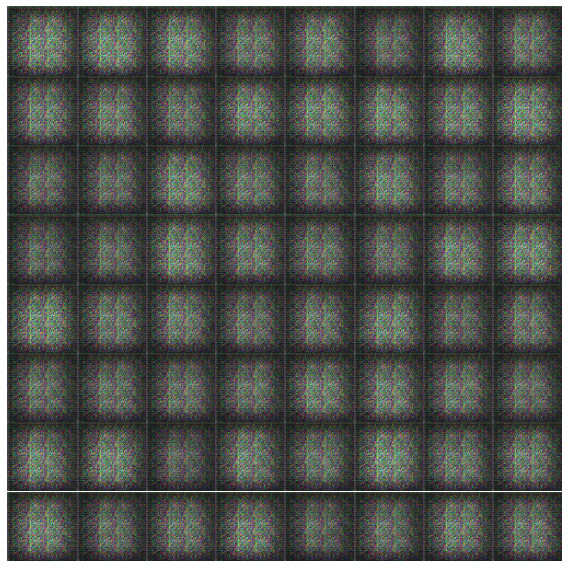

 Batch 50/150 Loss g(9.134690) | d(0.116087) - took 2.450631 s.
 Batch 51/150 Loss g(7.521139) | d(0.949116) - took 0.417818 s.
 Batch 52/150 Loss g(9.071210) | d(-0.090424) - took 0.280150 s.
 Batch 53/150 Loss g(7.397644) | d(0.137204) - took 0.347430 s.
 Batch 54/150 Loss g(14.108507) | d(0.931194) - took 0.340509 s.
 Batch 55/150 Loss g(11.120101) | d(1.341912) - took 0.344495 s.
 Batch 56/150 Loss g(6.860238) | d(0.440142) - took 0.341181 s.
 Batch 57/150 Loss g(18.274345) | d(1.610136) - took 0.339995 s.
 Batch 58/150 Loss g(18.197994) | d(2.149275) - took 0.346665 s.
 Batch 59/150 Loss g(12.481956) | d(0.055624) - took 0.363897 s.
 Batch 60/150 Loss g(9.592287) | d(0.903618) - took 0.346286 s.
 Batch 61/150 Loss g(11.817944) | d(0.928991) - took 0.344586 s.
 Batch 62/150 Loss g(6.617379) | d(1.039284) - took 0.343460 s.
 Batch 63/150 Loss g(10.787656) | d(5.945886) - took 0.345545 s.
 Batch 64/150 Loss g(4.728359) | d(2.031953) - took 0.344658 s.
 Batch 65/150 Loss g(5.576499) |

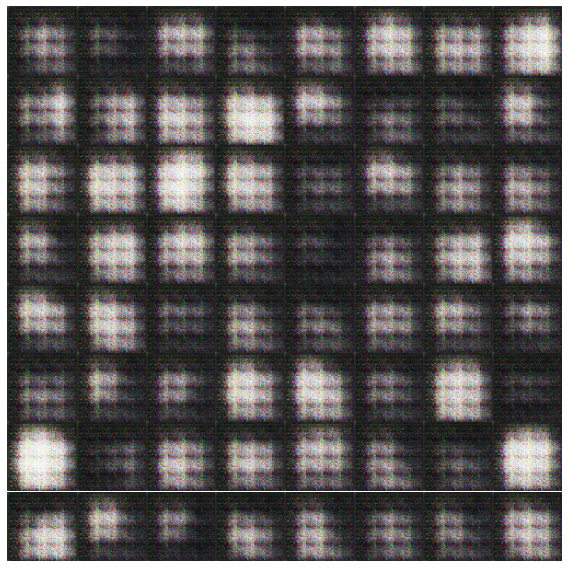

 Batch 100/150 Loss g(3.597980) | d(0.195882) - took 2.386873 s.
 Batch 101/150 Loss g(3.201541) | d(-0.074919) - took 0.462375 s.
 Batch 102/150 Loss g(4.160587) | d(0.496866) - took 0.345320 s.
 Batch 103/150 Loss g(3.496700) | d(0.171541) - took 0.344610 s.
 Batch 104/150 Loss g(4.621382) | d(0.070618) - took 0.283677 s.
 Batch 105/150 Loss g(4.100128) | d(0.138118) - took 0.346392 s.
 Batch 106/150 Loss g(4.572200) | d(0.473411) - took 0.349206 s.
 Batch 107/150 Loss g(6.127266) | d(0.779545) - took 0.343019 s.
 Batch 108/150 Loss g(4.419036) | d(0.744645) - took 0.344630 s.
 Batch 109/150 Loss g(3.737710) | d(0.566521) - took 0.350602 s.
 Batch 110/150 Loss g(5.073713) | d(0.471300) - took 0.338974 s.
 Batch 111/150 Loss g(2.890214) | d(0.661268) - took 0.342396 s.
 Batch 112/150 Loss g(5.385827) | d(0.582493) - took 0.349597 s.
 Batch 113/150 Loss g(6.115296) | d(0.502539) - took 0.351784 s.
 Batch 114/150 Loss g(5.187488) | d(2.082065) - took 0.350734 s.
 Batch 115/150 Loss g(4.

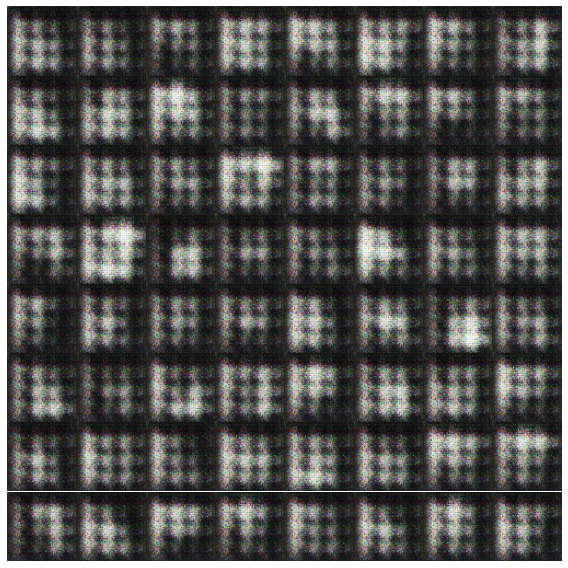

 Batch 150/150 Loss g(8.079279) | d(0.423734) - took 2.551715 s.


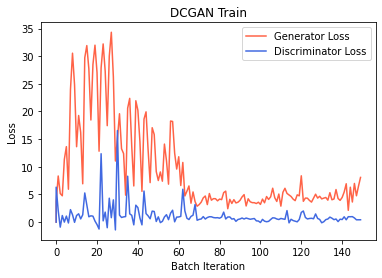

Epoch 2/120 :
 Batch 1/150 Loss g(2.940589) | d(0.933213) - took 0.341663 s.
 Batch 2/150 Loss g(8.376168) | d(0.305235) - took 0.341382 s.
 Batch 3/150 Loss g(10.670270) | d(0.440188) - took 0.356677 s.
 Batch 4/150 Loss g(5.207319) | d(0.940088) - took 0.342969 s.
 Batch 5/150 Loss g(3.861494) | d(0.629065) - took 0.343790 s.
 Batch 6/150 Loss g(4.319704) | d(0.578200) - took 0.291179 s.
 Batch 7/150 Loss g(5.004309) | d(0.633340) - took 0.349550 s.
 Batch 8/150 Loss g(3.672180) | d(0.183078) - took 0.343048 s.
 Batch 9/150 Loss g(6.313885) | d(0.771033) - took 0.348978 s.
 Batch 10/150 Loss g(6.425952) | d(0.617019) - took 0.349353 s.
 Batch 11/150 Loss g(2.771268) | d(0.364390) - took 0.345271 s.
 Batch 12/150 Loss g(7.936793) | d(0.867572) - took 0.347126 s.
 Batch 13/150 Loss g(8.861183) | d(0.544440) - took 0.339378 s.
 Batch 14/150 Loss g(2.930822) | d(0.989667) - took 0.341768 s.
 Batch 15/150 Loss g(7.507096) | d(1.117014) - took 0.345860 s.
 Batch 16/150 Loss g(8.076283) | d

<Figure size 432x288 with 0 Axes>

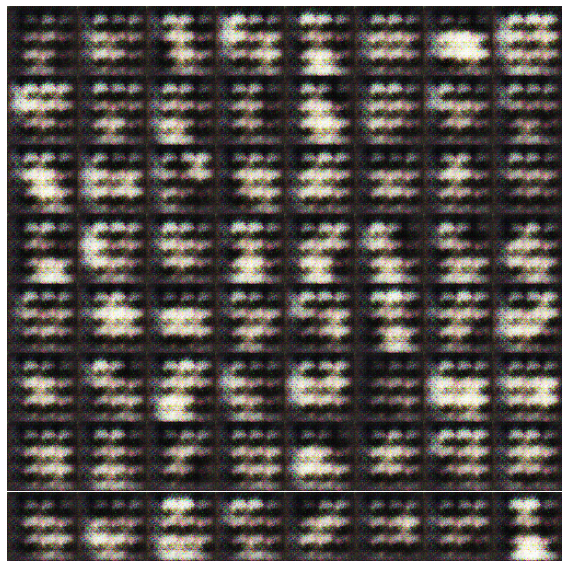

 Batch 50/150 Loss g(5.166071) | d(0.582614) - took 2.455245 s.
 Batch 51/150 Loss g(7.420139) | d(0.510517) - took 0.455667 s.
 Batch 52/150 Loss g(6.776106) | d(-0.035830) - took 0.345230 s.
 Batch 53/150 Loss g(5.425828) | d(0.504973) - took 0.346404 s.
 Batch 54/150 Loss g(6.339463) | d(0.067646) - took 0.346818 s.
 Batch 55/150 Loss g(4.939735) | d(-0.196370) - took 0.342484 s.
 Batch 56/150 Loss g(5.274309) | d(0.550379) - took 0.343224 s.
 Batch 57/150 Loss g(4.541107) | d(0.523131) - took 0.344684 s.
 Batch 58/150 Loss g(7.500069) | d(0.899218) - took 0.284984 s.
 Batch 59/150 Loss g(2.947000) | d(1.058218) - took 0.346905 s.
 Batch 60/150 Loss g(10.211119) | d(0.573237) - took 0.344835 s.
 Batch 61/150 Loss g(9.538358) | d(0.628338) - took 0.340408 s.
 Batch 62/150 Loss g(4.995514) | d(0.471145) - took 0.345374 s.
 Batch 63/150 Loss g(5.123222) | d(0.618302) - took 0.345780 s.
 Batch 64/150 Loss g(4.943751) | d(0.359145) - took 0.351002 s.
 Batch 65/150 Loss g(4.393571) | d(-0

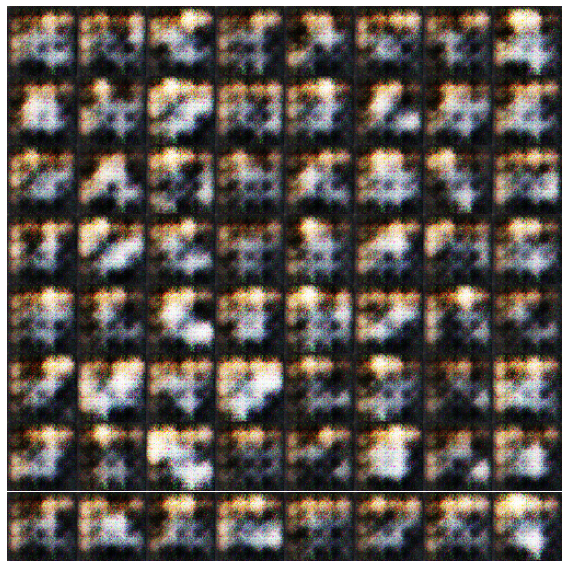

 Batch 100/150 Loss g(3.984874) | d(0.815917) - took 2.436080 s.
 Batch 101/150 Loss g(7.917177) | d(0.595624) - took 0.450050 s.
 Batch 102/150 Loss g(7.717793) | d(0.098010) - took 0.337934 s.
 Batch 103/150 Loss g(4.554212) | d(-0.181486) - took 0.344839 s.
 Batch 104/150 Loss g(8.077365) | d(1.089735) - took 0.341903 s.
 Batch 105/150 Loss g(6.618501) | d(0.678871) - took 0.344547 s.
 Batch 106/150 Loss g(6.926744) | d(0.823773) - took 0.342778 s.
 Batch 107/150 Loss g(4.127095) | d(0.231610) - took 0.347023 s.
 Batch 108/150 Loss g(7.605761) | d(0.714830) - took 0.337992 s.
 Batch 109/150 Loss g(6.222140) | d(0.653793) - took 0.344675 s.
 Batch 110/150 Loss g(6.419199) | d(0.324856) - took 0.287211 s.
 Batch 111/150 Loss g(5.553332) | d(-0.061668) - took 0.344435 s.
 Batch 112/150 Loss g(5.110887) | d(0.439704) - took 0.348033 s.
 Batch 113/150 Loss g(5.101783) | d(0.508053) - took 0.347318 s.
 Batch 114/150 Loss g(7.065432) | d(0.641528) - took 0.342049 s.
 Batch 115/150 Loss g(1

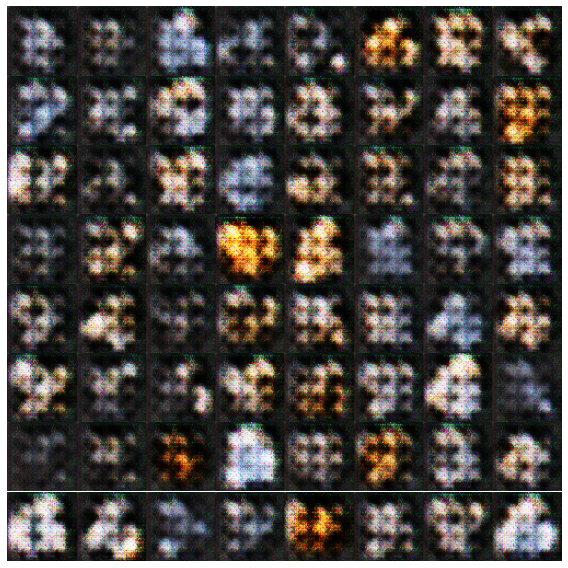

 Batch 150/150 Loss g(6.403956) | d(0.904380) - took 2.464737 s.


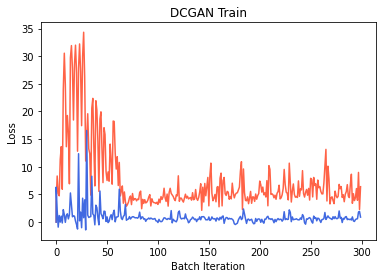

Epoch 3/120 :
 Batch 1/150 Loss g(5.223536) | d(0.313695) - took 0.359734 s.
 Batch 2/150 Loss g(3.934855) | d(0.478304) - took 0.342463 s.
 Batch 3/150 Loss g(6.564979) | d(0.737166) - took 0.340603 s.
 Batch 4/150 Loss g(4.115688) | d(0.836049) - took 0.340850 s.
 Batch 5/150 Loss g(3.921507) | d(0.491797) - took 0.344515 s.
 Batch 6/150 Loss g(4.386397) | d(0.231554) - took 0.349866 s.
 Batch 7/150 Loss g(5.691081) | d(0.412184) - took 0.349851 s.
 Batch 8/150 Loss g(3.029019) | d(0.436142) - took 0.347879 s.
 Batch 9/150 Loss g(5.580502) | d(-0.092476) - took 0.345070 s.
 Batch 10/150 Loss g(4.585725) | d(-0.125960) - took 0.342741 s.
 Batch 11/150 Loss g(3.927711) | d(0.441467) - took 0.347393 s.
 Batch 12/150 Loss g(3.539055) | d(-0.080454) - took 0.286660 s.
 Batch 13/150 Loss g(3.876919) | d(-0.062448) - took 0.344728 s.
 Batch 14/150 Loss g(4.676333) | d(0.430386) - took 0.342796 s.
 Batch 15/150 Loss g(9.181616) | d(1.600865) - took 0.358295 s.
 Batch 16/150 Loss g(3.652430) 

<Figure size 432x288 with 0 Axes>

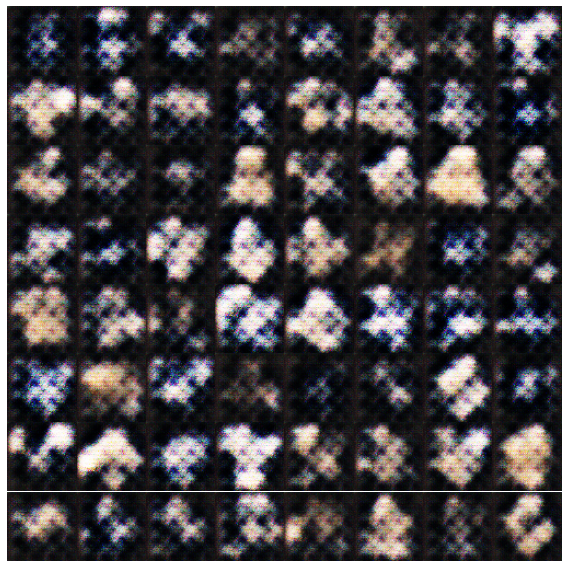

 Batch 50/150 Loss g(4.041326) | d(0.869936) - took 2.501996 s.
 Batch 51/150 Loss g(4.703230) | d(0.443914) - took 0.365802 s.
 Batch 52/150 Loss g(2.762984) | d(0.471032) - took 0.340192 s.
 Batch 53/150 Loss g(4.117229) | d(-0.051222) - took 0.346764 s.
 Batch 54/150 Loss g(4.019969) | d(-0.178026) - took 0.349988 s.
 Batch 55/150 Loss g(4.719885) | d(0.466201) - took 0.341545 s.
 Batch 56/150 Loss g(4.518487) | d(0.438322) - took 0.346243 s.
 Batch 57/150 Loss g(5.422256) | d(0.910903) - took 0.348582 s.
 Batch 58/150 Loss g(4.681815) | d(0.076022) - took 0.344930 s.
 Batch 59/150 Loss g(4.707957) | d(0.461520) - took 0.339923 s.
 Batch 60/150 Loss g(4.145586) | d(0.116743) - took 0.340533 s.
 Batch 61/150 Loss g(4.598412) | d(-0.061206) - took 0.349076 s.
 Batch 62/150 Loss g(3.952228) | d(-0.084028) - took 0.346995 s.
 Batch 63/150 Loss g(5.169135) | d(0.502888) - took 0.349783 s.
 Batch 64/150 Loss g(5.232673) | d(0.632588) - took 0.284344 s.
 Batch 65/150 Loss g(8.343336) | d(1

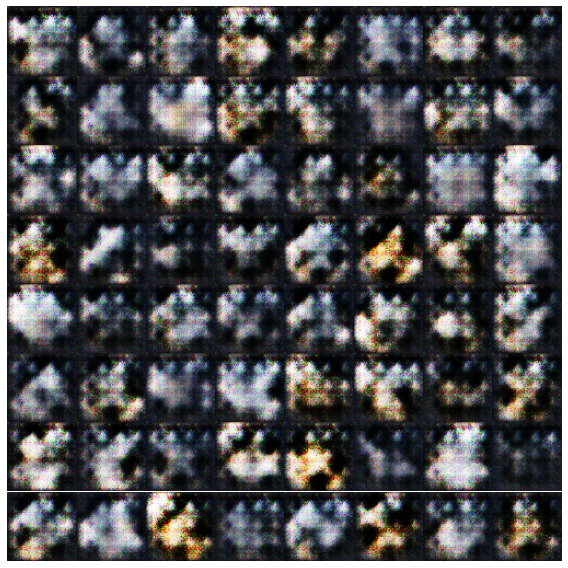

 Batch 100/150 Loss g(3.447626) | d(-0.283811) - took 2.447292 s.
 Batch 101/150 Loss g(5.185907) | d(-0.003619) - took 0.477801 s.
 Batch 102/150 Loss g(6.749044) | d(0.454513) - took 0.346916 s.
 Batch 103/150 Loss g(4.212120) | d(1.389323) - took 0.282748 s.
 Batch 104/150 Loss g(6.377114) | d(0.468845) - took 0.348286 s.
 Batch 105/150 Loss g(4.030435) | d(0.625741) - took 0.343029 s.
 Batch 106/150 Loss g(4.759326) | d(0.303732) - took 0.343597 s.
 Batch 107/150 Loss g(4.215755) | d(-0.053642) - took 0.348494 s.
 Batch 108/150 Loss g(4.689294) | d(-0.077295) - took 0.346860 s.
 Batch 109/150 Loss g(5.229748) | d(0.104539) - took 0.342871 s.
 Batch 110/150 Loss g(5.515821) | d(0.371496) - took 0.349608 s.
 Batch 111/150 Loss g(3.079720) | d(0.566686) - took 0.344214 s.
 Batch 112/150 Loss g(5.259607) | d(0.719099) - took 0.345260 s.
 Batch 113/150 Loss g(5.364729) | d(0.796665) - took 0.348351 s.
 Batch 114/150 Loss g(9.560881) | d(1.436544) - took 0.352290 s.
 Batch 115/150 Loss g

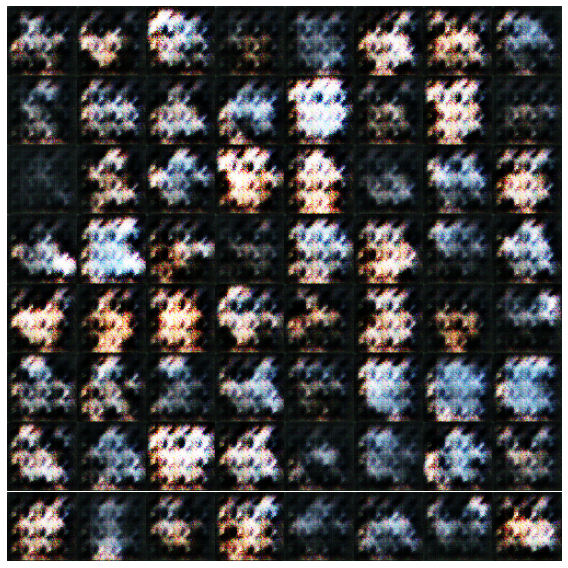

 Batch 150/150 Loss g(7.276793) | d(0.665616) - took 2.485531 s.


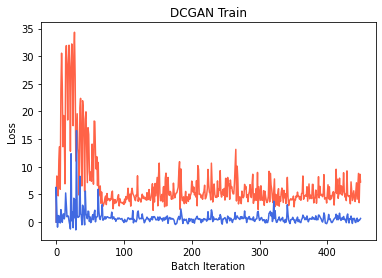

Epoch 4/120 :
 Batch 1/150 Loss g(4.742790) | d(0.447909) - took 0.337416 s.
 Batch 2/150 Loss g(4.991268) | d(0.544467) - took 0.340557 s.
 Batch 3/150 Loss g(6.096636) | d(0.658581) - took 0.344537 s.
 Batch 4/150 Loss g(7.142222) | d(0.382020) - took 0.349098 s.
 Batch 5/150 Loss g(4.191300) | d(0.233018) - took 0.290717 s.
 Batch 6/150 Loss g(7.527428) | d(0.335577) - took 0.350878 s.
 Batch 7/150 Loss g(2.581510) | d(0.682469) - took 0.345321 s.
 Batch 8/150 Loss g(10.707943) | d(0.952433) - took 0.344521 s.
 Batch 9/150 Loss g(5.075566) | d(1.449633) - took 0.348496 s.
 Batch 10/150 Loss g(5.958583) | d(0.202736) - took 0.350094 s.
 Batch 11/150 Loss g(6.600899) | d(0.439667) - took 0.343310 s.
 Batch 12/150 Loss g(2.409857) | d(0.970009) - took 0.344394 s.
 Batch 13/150 Loss g(7.462879) | d(1.368133) - took 0.340701 s.
 Batch 14/150 Loss g(3.054845) | d(1.070037) - took 0.352699 s.
 Batch 15/150 Loss g(3.151397) | d(0.783360) - took 0.341765 s.
 Batch 16/150 Loss g(3.786670) | d

<Figure size 432x288 with 0 Axes>

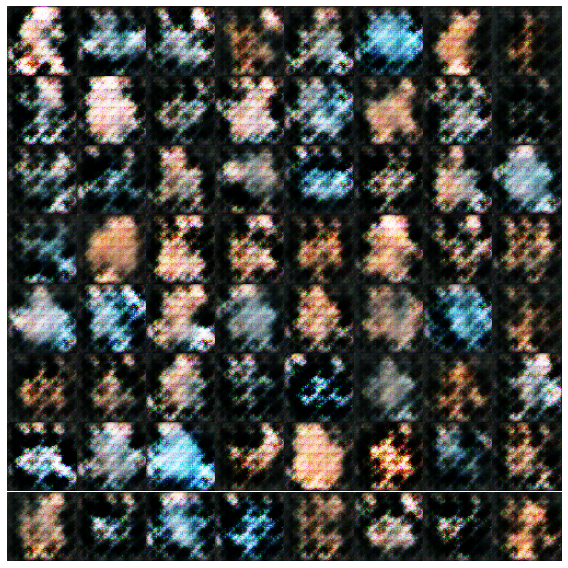

 Batch 50/150 Loss g(6.730674) | d(0.359543) - took 2.505193 s.
 Batch 51/150 Loss g(3.112071) | d(1.087199) - took 0.488766 s.
 Batch 52/150 Loss g(4.928404) | d(0.678900) - took 0.343060 s.
 Batch 53/150 Loss g(3.474122) | d(0.088576) - took 0.346739 s.
 Batch 54/150 Loss g(4.744897) | d(0.645679) - took 0.343577 s.
 Batch 55/150 Loss g(4.211318) | d(0.538311) - took 0.341629 s.
 Batch 56/150 Loss g(4.882006) | d(1.046620) - took 0.338837 s.
 Batch 57/150 Loss g(5.540037) | d(0.854687) - took 0.294510 s.
 Batch 58/150 Loss g(4.841319) | d(0.097810) - took 0.346203 s.
 Batch 59/150 Loss g(5.732436) | d(0.486703) - took 0.343942 s.
 Batch 60/150 Loss g(4.521146) | d(0.624386) - took 0.355728 s.
 Batch 61/150 Loss g(6.669643) | d(0.393980) - took 0.343720 s.
 Batch 62/150 Loss g(3.664442) | d(0.379854) - took 0.344485 s.
 Batch 63/150 Loss g(6.995176) | d(0.213090) - took 0.356152 s.
 Batch 64/150 Loss g(6.335771) | d(-0.144522) - took 0.349925 s.
 Batch 65/150 Loss g(5.009724) | d(0.42

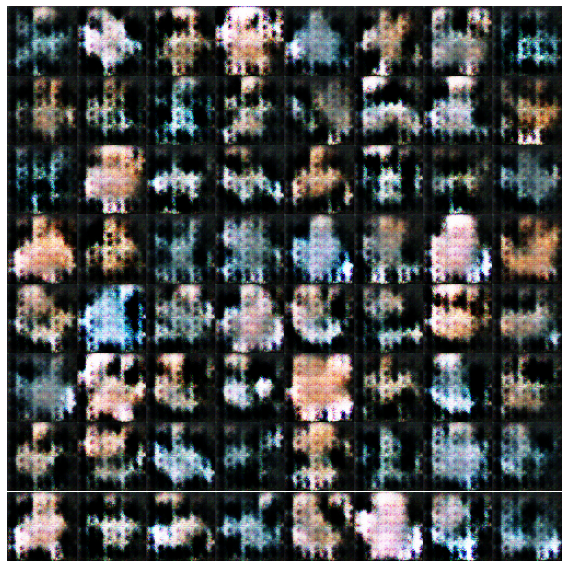

 Batch 100/150 Loss g(4.281322) | d(0.994474) - took 2.441761 s.
 Batch 101/150 Loss g(5.842720) | d(0.499479) - took 0.462303 s.
 Batch 102/150 Loss g(2.993456) | d(0.718616) - took 0.343827 s.
 Batch 103/150 Loss g(6.846939) | d(0.546251) - took 0.350829 s.
 Batch 104/150 Loss g(5.235985) | d(0.766020) - took 0.354735 s.
 Batch 105/150 Loss g(3.232086) | d(-0.095037) - took 0.357623 s.
 Batch 106/150 Loss g(5.162080) | d(0.645092) - took 0.348603 s.
 Batch 107/150 Loss g(4.581429) | d(0.433850) - took 0.351142 s.
 Batch 108/150 Loss g(6.480435) | d(0.930724) - took 0.347183 s.
 Batch 109/150 Loss g(5.080843) | d(0.152016) - took 0.282852 s.
 Batch 110/150 Loss g(4.500252) | d(0.575782) - took 0.344239 s.
 Batch 111/150 Loss g(4.727443) | d(0.539207) - took 0.353218 s.
 Batch 112/150 Loss g(4.299702) | d(0.670471) - took 0.345667 s.
 Batch 113/150 Loss g(4.250689) | d(0.657449) - took 0.348544 s.
 Batch 114/150 Loss g(4.298516) | d(0.443246) - took 0.345773 s.
 Batch 115/150 Loss g(4.

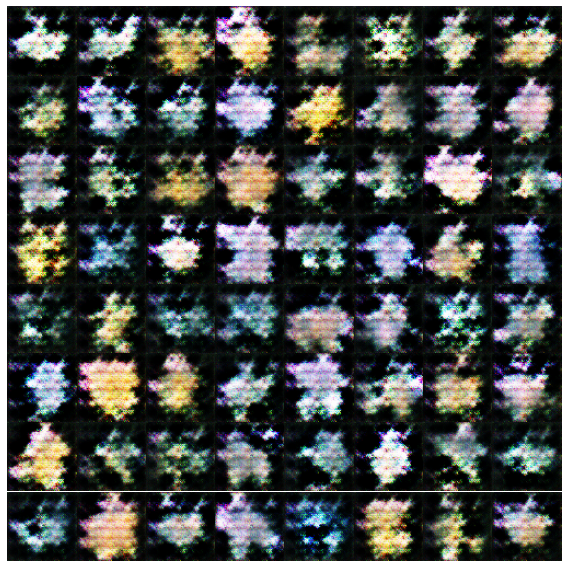

 Batch 150/150 Loss g(6.667327) | d(0.951918) - took 2.430792 s.


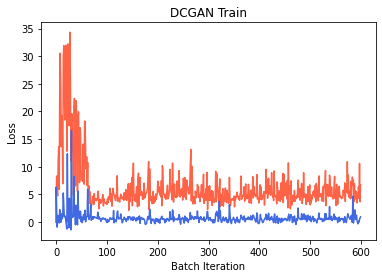

Epoch 5/120 :
 Batch 1/150 Loss g(4.763051) | d(-0.037274) - took 0.348590 s.
 Batch 2/150 Loss g(4.595832) | d(0.569814) - took 0.343435 s.
 Batch 3/150 Loss g(8.485394) | d(1.632034) - took 0.341912 s.
 Batch 4/150 Loss g(3.068418) | d(1.599134) - took 0.354974 s.
 Batch 5/150 Loss g(8.397133) | d(0.695284) - took 0.346450 s.
 Batch 6/150 Loss g(9.666662) | d(0.500008) - took 0.348331 s.
 Batch 7/150 Loss g(3.081333) | d(0.942399) - took 0.349103 s.
 Batch 8/150 Loss g(7.232365) | d(1.147012) - took 0.343499 s.
 Batch 9/150 Loss g(8.317052) | d(0.583675) - took 0.343698 s.
 Batch 10/150 Loss g(3.565511) | d(0.960127) - took 0.345055 s.
 Batch 11/150 Loss g(5.953068) | d(0.410141) - took 0.287269 s.
 Batch 12/150 Loss g(8.236359) | d(0.438569) - took 0.343414 s.
 Batch 13/150 Loss g(4.360954) | d(0.768552) - took 0.345248 s.
 Batch 14/150 Loss g(6.263276) | d(0.312958) - took 0.344683 s.
 Batch 15/150 Loss g(7.384545) | d(0.437483) - took 0.344555 s.
 Batch 16/150 Loss g(3.130282) | d

<Figure size 432x288 with 0 Axes>

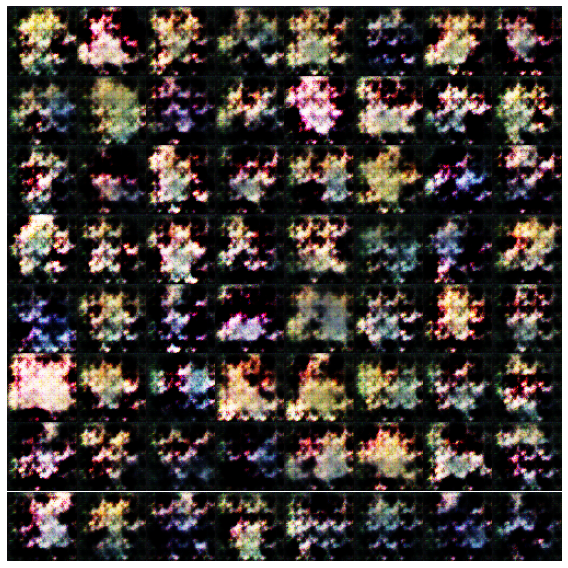

 Batch 100/150 Loss g(7.473924) | d(0.434627) - took 2.485629 s.
 Batch 101/150 Loss g(5.419019) | d(0.999379) - took 0.464902 s.
 Batch 102/150 Loss g(6.831478) | d(0.466455) - took 0.282969 s.
 Batch 103/150 Loss g(4.778314) | d(0.437178) - took 0.346419 s.
 Batch 104/150 Loss g(8.979146) | d(0.985941) - took 0.349155 s.
 Batch 105/150 Loss g(6.663548) | d(0.874852) - took 0.348653 s.
 Batch 106/150 Loss g(4.864042) | d(0.446122) - took 0.346470 s.
 Batch 107/150 Loss g(4.782501) | d(0.491075) - took 0.350443 s.
 Batch 108/150 Loss g(5.324952) | d(0.695224) - took 0.352647 s.
 Batch 109/150 Loss g(4.842611) | d(0.553430) - took 0.352869 s.
 Batch 110/150 Loss g(4.908852) | d(0.077062) - took 0.344604 s.
 Batch 111/150 Loss g(4.460522) | d(-0.139141) - took 0.347306 s.
 Batch 112/150 Loss g(5.178926) | d(0.491660) - took 0.348445 s.
 Batch 113/150 Loss g(4.116197) | d(-0.052109) - took 0.353506 s.
 Batch 114/150 Loss g(4.620162) | d(-0.226286) - took 0.348913 s.
 Batch 115/150 Loss g(

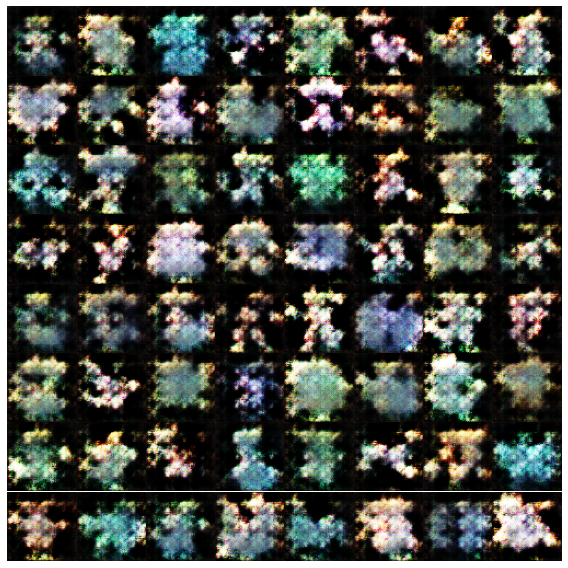

 Batch 150/150 Loss g(7.179581) | d(0.410738) - took 2.443884 s.


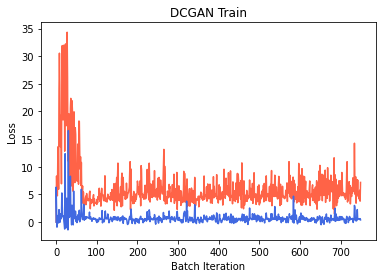

Epoch 6/120 :
 Batch 1/150 Loss g(3.765468) | d(0.341545) - took 0.371508 s.
 Batch 2/150 Loss g(4.779028) | d(0.731312) - took 0.348843 s.
 Batch 3/150 Loss g(5.094068) | d(-0.057977) - took 0.349779 s.
 Batch 4/150 Loss g(5.469335) | d(0.431841) - took 0.280946 s.
 Batch 5/150 Loss g(6.711894) | d(0.478308) - took 0.346442 s.
 Batch 6/150 Loss g(7.065451) | d(0.470530) - took 0.350828 s.
 Batch 7/150 Loss g(5.289161) | d(0.444469) - took 0.353070 s.
 Batch 8/150 Loss g(4.770168) | d(0.437988) - took 0.344860 s.
 Batch 9/150 Loss g(4.372324) | d(0.464632) - took 0.342242 s.
 Batch 10/150 Loss g(9.763393) | d(0.963574) - took 0.347418 s.
 Batch 11/150 Loss g(6.855687) | d(0.940490) - took 0.346905 s.
 Batch 12/150 Loss g(5.457753) | d(0.442525) - took 0.345021 s.
 Batch 13/150 Loss g(4.890981) | d(0.520721) - took 0.341867 s.
 Batch 14/150 Loss g(5.443368) | d(0.725994) - took 0.345496 s.
 Batch 15/150 Loss g(4.708059) | d(0.075769) - took 0.348810 s.
 Batch 16/150 Loss g(5.251815) | d

<Figure size 432x288 with 0 Axes>

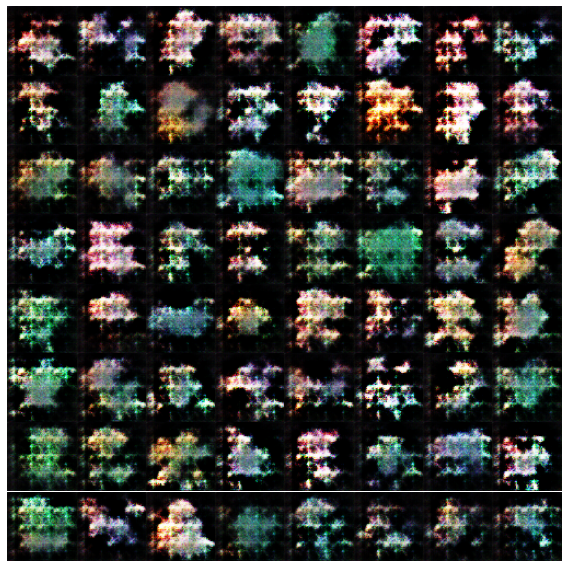

 Batch 50/150 Loss g(6.973500) | d(1.048325) - took 2.516579 s.
 Batch 51/150 Loss g(8.072838) | d(0.413665) - took 0.430389 s.
 Batch 52/150 Loss g(4.335918) | d(0.634056) - took 0.348784 s.
 Batch 53/150 Loss g(3.691935) | d(0.490986) - took 0.346487 s.
 Batch 54/150 Loss g(3.892938) | d(0.462060) - took 0.348735 s.
 Batch 55/150 Loss g(3.712414) | d(0.483994) - took 0.353088 s.
 Batch 56/150 Loss g(6.603097) | d(1.069668) - took 0.287789 s.
 Batch 57/150 Loss g(7.364727) | d(0.581630) - took 0.347670 s.
 Batch 58/150 Loss g(3.010891) | d(0.705604) - took 0.352452 s.
 Batch 59/150 Loss g(6.847516) | d(-0.000441) - took 0.346421 s.
 Batch 60/150 Loss g(6.733097) | d(-0.294028) - took 0.350300 s.
 Batch 61/150 Loss g(4.543032) | d(-0.027166) - took 0.353435 s.
 Batch 62/150 Loss g(5.051842) | d(-0.103077) - took 0.347569 s.
 Batch 63/150 Loss g(5.663029) | d(-0.128697) - took 0.352605 s.
 Batch 64/150 Loss g(7.253432) | d(0.450203) - took 0.350978 s.
 Batch 65/150 Loss g(9.765415) | d(

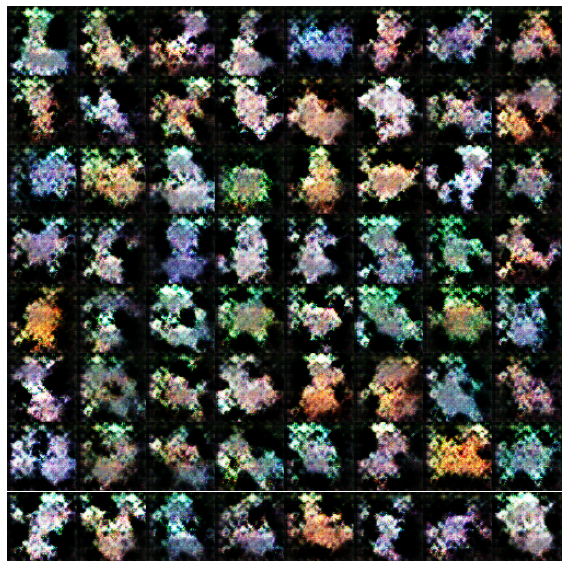

 Batch 100/150 Loss g(4.109650) | d(0.595707) - took 2.448579 s.
 Batch 101/150 Loss g(6.713356) | d(-0.089490) - took 0.430323 s.
 Batch 102/150 Loss g(6.136247) | d(-0.397057) - took 0.350836 s.
 Batch 103/150 Loss g(3.571172) | d(-0.046087) - took 0.345387 s.
 Batch 104/150 Loss g(5.375212) | d(0.686629) - took 0.355815 s.
 Batch 105/150 Loss g(4.277185) | d(0.568549) - took 0.347585 s.
 Batch 106/150 Loss g(9.835348) | d(1.317409) - took 0.349860 s.
 Batch 107/150 Loss g(4.034966) | d(1.584445) - took 0.343575 s.
 Batch 108/150 Loss g(8.692862) | d(0.725251) - took 0.286254 s.
 Batch 109/150 Loss g(7.588702) | d(0.006348) - took 0.347912 s.
 Batch 110/150 Loss g(4.746086) | d(-0.150162) - took 0.347938 s.
 Batch 111/150 Loss g(7.460250) | d(-0.015500) - took 0.348463 s.
 Batch 112/150 Loss g(5.963838) | d(-0.093533) - took 0.347489 s.
 Batch 113/150 Loss g(7.261862) | d(0.117180) - took 0.352151 s.
 Batch 114/150 Loss g(7.560398) | d(0.444217) - took 0.348578 s.
 Batch 115/150 Loss

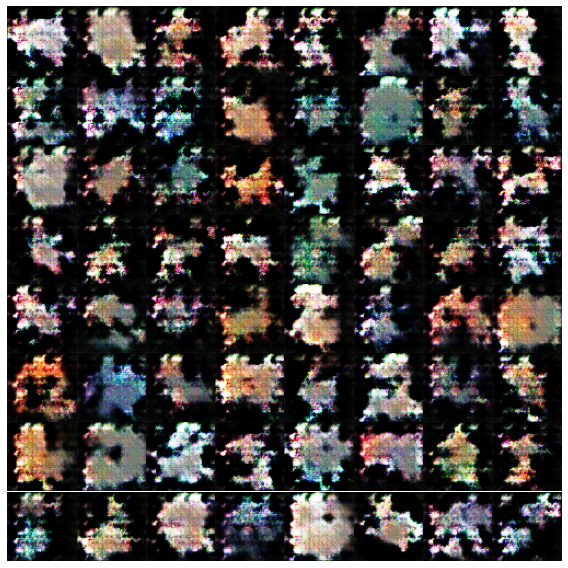

 Batch 150/150 Loss g(6.825103) | d(0.133893) - took 2.449564 s.


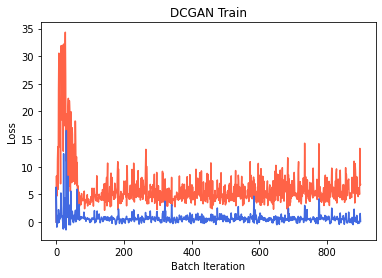

Epoch 7/120 :
 Batch 1/150 Loss g(5.472471) | d(-0.178036) - took 0.344918 s.
 Batch 2/150 Loss g(6.100721) | d(0.625497) - took 0.349644 s.
 Batch 3/150 Loss g(6.714427) | d(0.734125) - took 0.348284 s.
 Batch 4/150 Loss g(7.155337) | d(0.511937) - took 0.352197 s.
 Batch 5/150 Loss g(3.960396) | d(0.675744) - took 0.351513 s.
 Batch 6/150 Loss g(5.331191) | d(0.673944) - took 0.344953 s.
 Batch 7/150 Loss g(4.538664) | d(0.488844) - took 0.351250 s.
 Batch 8/150 Loss g(11.238729) | d(1.321885) - took 0.345516 s.
 Batch 9/150 Loss g(5.405682) | d(1.444528) - took 0.348585 s.
 Batch 10/150 Loss g(6.139731) | d(0.897556) - took 0.286232 s.
 Batch 11/150 Loss g(6.973366) | d(0.656214) - took 0.342222 s.
 Batch 12/150 Loss g(8.299617) | d(0.517621) - took 0.347594 s.
 Batch 13/150 Loss g(3.902125) | d(0.833394) - took 0.346707 s.
 Batch 14/150 Loss g(8.172621) | d(0.737403) - took 0.351255 s.
 Batch 15/150 Loss g(6.154195) | d(0.397421) - took 0.347536 s.
 Batch 16/150 Loss g(4.215375) | 

<Figure size 432x288 with 0 Axes>

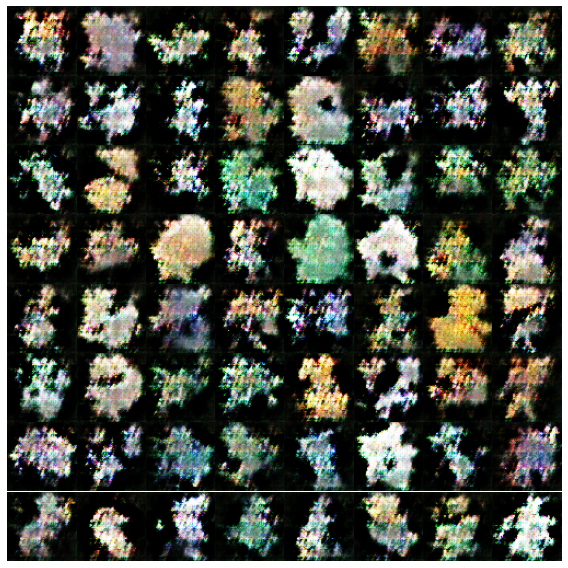

 Batch 50/150 Loss g(7.388494) | d(0.003461) - took 2.421112 s.
 Batch 51/150 Loss g(6.134471) | d(-0.186069) - took 0.455854 s.
 Batch 52/150 Loss g(5.635746) | d(0.473908) - took 0.345953 s.
 Batch 53/150 Loss g(6.660118) | d(0.604949) - took 0.349840 s.
 Batch 54/150 Loss g(8.353674) | d(0.403323) - took 0.365433 s.
 Batch 55/150 Loss g(3.376091) | d(0.953450) - took 0.346076 s.
 Batch 56/150 Loss g(9.001225) | d(0.278607) - took 0.343711 s.
 Batch 57/150 Loss g(8.350541) | d(0.005054) - took 0.345016 s.
 Batch 58/150 Loss g(5.868044) | d(0.484032) - took 0.340692 s.
 Batch 59/150 Loss g(6.448389) | d(0.169120) - took 0.342905 s.
 Batch 60/150 Loss g(5.208175) | d(-0.162898) - took 0.346793 s.
 Batch 61/150 Loss g(7.580014) | d(-0.008850) - took 0.344717 s.
 Batch 62/150 Loss g(8.565761) | d(0.398694) - took 0.287099 s.
 Batch 63/150 Loss g(4.451958) | d(0.629591) - took 0.354172 s.
 Batch 64/150 Loss g(8.160105) | d(0.821116) - took 0.340951 s.
 Batch 65/150 Loss g(4.327713) | d(0.

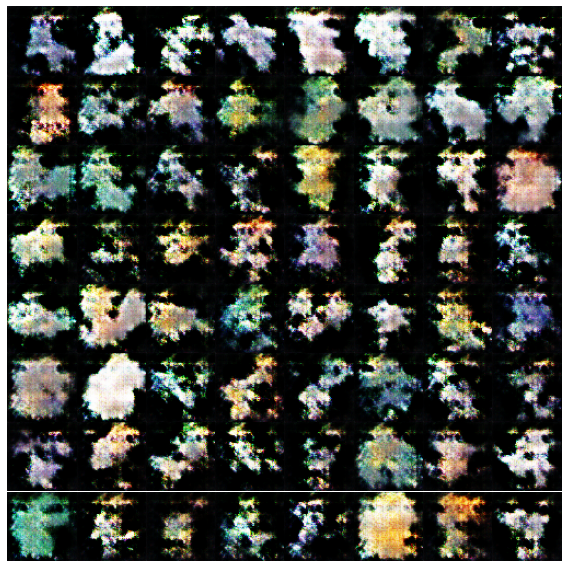

 Batch 100/150 Loss g(8.669909) | d(-0.206047) - took 2.426359 s.
 Batch 101/150 Loss g(6.704179) | d(0.434298) - took 0.374084 s.
 Batch 102/150 Loss g(5.076540) | d(0.483657) - took 0.343798 s.
 Batch 103/150 Loss g(8.666225) | d(0.724078) - took 0.344963 s.
 Batch 104/150 Loss g(8.632235) | d(0.475315) - took 0.346400 s.
 Batch 105/150 Loss g(4.384391) | d(0.096316) - took 0.340144 s.
 Batch 106/150 Loss g(7.684318) | d(-0.151739) - took 0.346424 s.
 Batch 107/150 Loss g(6.984437) | d(-0.277503) - took 0.349877 s.
 Batch 108/150 Loss g(6.061738) | d(-0.071963) - took 0.343545 s.
 Batch 109/150 Loss g(5.885303) | d(-0.348404) - took 0.347990 s.
 Batch 110/150 Loss g(8.918574) | d(-0.082932) - took 0.352903 s.
 Batch 111/150 Loss g(9.890075) | d(0.528184) - took 0.350755 s.
 Batch 112/150 Loss g(10.008895) | d(1.731525) - took 0.348939 s.
 Batch 113/150 Loss g(6.831661) | d(0.396848) - took 0.355111 s.
 Batch 114/150 Loss g(6.714475) | d(-0.008203) - took 0.292910 s.
 Batch 115/150 Lo

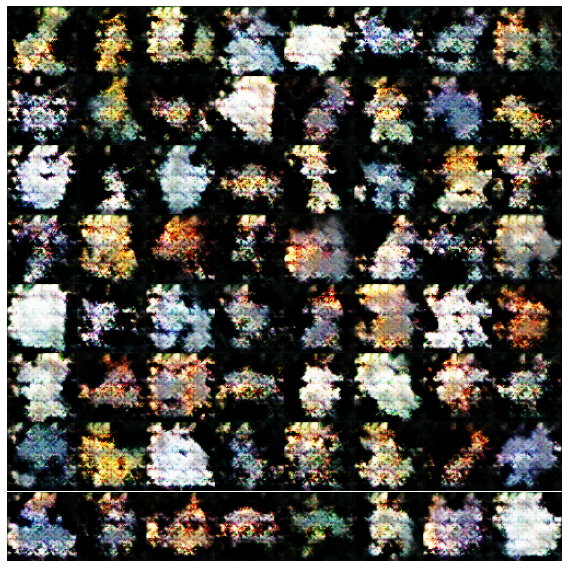

 Batch 150/150 Loss g(6.893586) | d(0.408463) - took 2.412894 s.


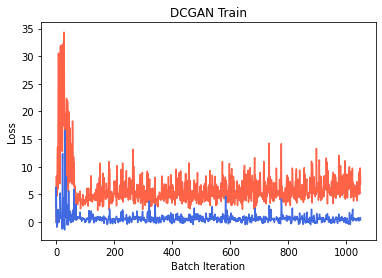

Epoch 8/120 :
 Batch 1/150 Loss g(4.844612) | d(-0.326492) - took 0.353789 s.
 Batch 2/150 Loss g(5.646878) | d(-0.416397) - took 0.348109 s.
 Batch 3/150 Loss g(6.755617) | d(0.708717) - took 0.287928 s.
 Batch 4/150 Loss g(5.568386) | d(0.474415) - took 0.349162 s.
 Batch 5/150 Loss g(6.421467) | d(0.834476) - took 0.349782 s.
 Batch 6/150 Loss g(4.678308) | d(0.684612) - took 0.351660 s.
 Batch 7/150 Loss g(5.203426) | d(0.467915) - took 0.362025 s.
 Batch 8/150 Loss g(6.954688) | d(0.430573) - took 0.348798 s.
 Batch 9/150 Loss g(5.262335) | d(0.059588) - took 0.347903 s.
 Batch 10/150 Loss g(6.981419) | d(-0.085762) - took 0.353663 s.
 Batch 11/150 Loss g(9.062025) | d(0.468329) - took 0.342038 s.
 Batch 12/150 Loss g(3.374705) | d(0.599295) - took 0.342031 s.
 Batch 13/150 Loss g(5.289536) | d(0.701670) - took 0.352498 s.
 Batch 14/150 Loss g(5.900402) | d(0.449576) - took 0.343282 s.
 Batch 15/150 Loss g(9.237946) | d(1.145042) - took 0.347732 s.
 Batch 16/150 Loss g(9.475458) |

<Figure size 432x288 with 0 Axes>

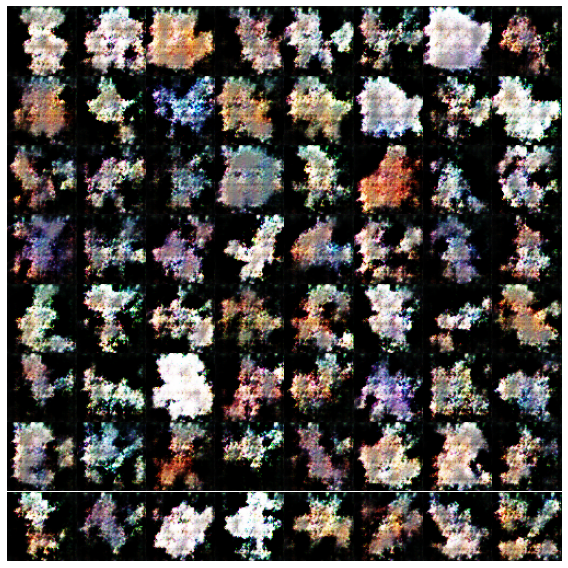

 Batch 50/150 Loss g(10.518758) | d(0.442734) - took 2.455541 s.
 Batch 51/150 Loss g(3.231291) | d(1.130139) - took 0.451085 s.
 Batch 52/150 Loss g(6.125305) | d(0.989440) - took 0.349388 s.
 Batch 53/150 Loss g(7.445388) | d(0.420341) - took 0.347899 s.
 Batch 54/150 Loss g(4.254526) | d(0.635790) - took 0.362928 s.
 Batch 55/150 Loss g(5.146706) | d(0.579843) - took 0.290418 s.
 Batch 56/150 Loss g(6.273207) | d(0.379665) - took 0.345178 s.
 Batch 57/150 Loss g(5.577013) | d(-0.236288) - took 0.353671 s.
 Batch 58/150 Loss g(5.900960) | d(0.528092) - took 0.351559 s.
 Batch 59/150 Loss g(6.050541) | d(0.492660) - took 0.347791 s.
 Batch 60/150 Loss g(5.520264) | d(0.752601) - took 0.346765 s.
 Batch 61/150 Loss g(6.270993) | d(0.411780) - took 0.352323 s.
 Batch 62/150 Loss g(5.420281) | d(-0.211672) - took 0.347735 s.
 Batch 63/150 Loss g(5.261536) | d(-0.268893) - took 0.349101 s.
 Batch 64/150 Loss g(6.368858) | d(0.637349) - took 0.345453 s.
 Batch 65/150 Loss g(4.494942) | d(0

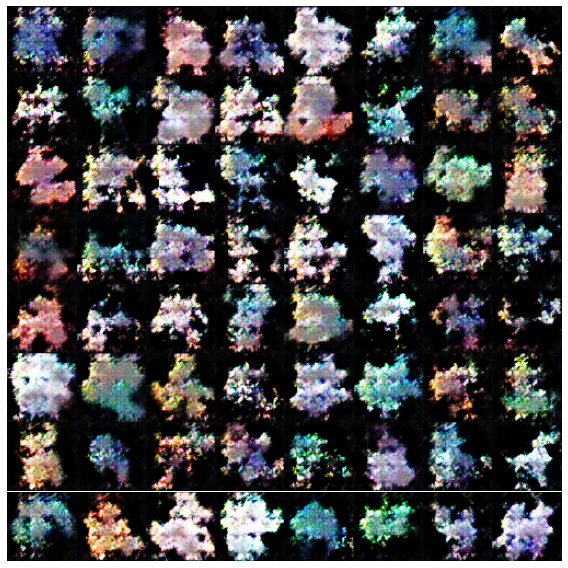

 Batch 100/150 Loss g(7.152993) | d(0.536839) - took 2.406766 s.
 Batch 101/150 Loss g(8.088980) | d(0.866653) - took 0.468866 s.
 Batch 102/150 Loss g(9.499985) | d(0.496571) - took 0.343833 s.
 Batch 103/150 Loss g(5.790420) | d(0.538984) - took 0.339289 s.
 Batch 104/150 Loss g(6.209663) | d(0.167825) - took 0.348588 s.
 Batch 105/150 Loss g(5.308775) | d(-0.273409) - took 0.345560 s.
 Batch 106/150 Loss g(5.496931) | d(0.532247) - took 0.343592 s.
 Batch 107/150 Loss g(7.656515) | d(0.317290) - took 0.293447 s.
 Batch 108/150 Loss g(6.568484) | d(-0.223966) - took 0.357536 s.
 Batch 109/150 Loss g(5.838990) | d(0.430370) - took 0.347400 s.
 Batch 110/150 Loss g(7.081532) | d(0.409608) - took 0.349725 s.
 Batch 111/150 Loss g(9.224274) | d(0.398468) - took 0.347372 s.
 Batch 112/150 Loss g(2.584036) | d(0.350378) - took 0.343740 s.
 Batch 113/150 Loss g(11.795288) | d(0.863760) - took 0.363656 s.
 Batch 114/150 Loss g(10.940744) | d(0.279410) - took 0.348560 s.
 Batch 115/150 Loss g

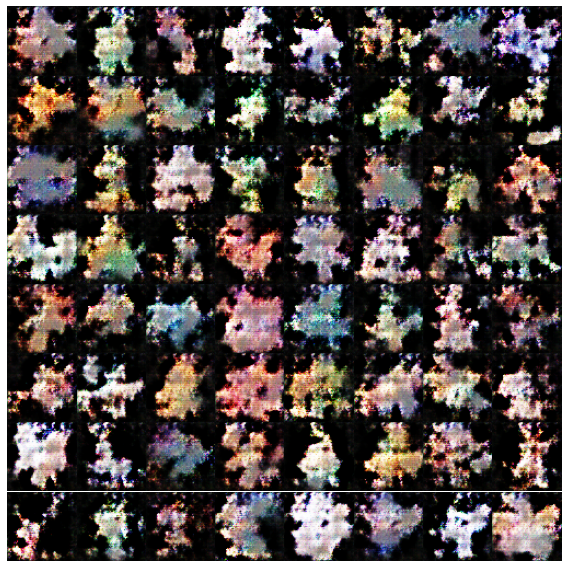

 Batch 150/150 Loss g(4.717747) | d(0.929228) - took 2.421011 s.


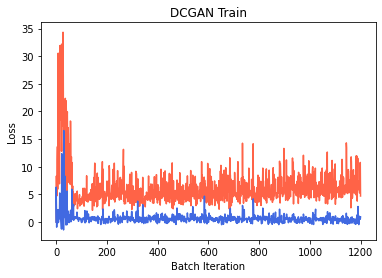

Epoch 9/120 :
 Batch 1/150 Loss g(5.651259) | d(0.798288) - took 0.341583 s.
 Batch 2/150 Loss g(5.168237) | d(0.260921) - took 0.351948 s.
 Batch 3/150 Loss g(5.581625) | d(-0.081492) - took 0.350463 s.
 Batch 4/150 Loss g(5.164207) | d(-0.236605) - took 0.347173 s.
 Batch 5/150 Loss g(5.939895) | d(0.558596) - took 0.345163 s.
 Batch 6/150 Loss g(7.453048) | d(0.881279) - took 0.349080 s.
 Batch 7/150 Loss g(5.856828) | d(0.534764) - took 0.354399 s.
 Batch 8/150 Loss g(7.352817) | d(0.725501) - took 0.342059 s.
 Batch 9/150 Loss g(5.525054) | d(0.221727) - took 0.290927 s.
 Batch 10/150 Loss g(6.137146) | d(-0.070204) - took 0.343510 s.
 Batch 11/150 Loss g(7.252343) | d(0.463999) - took 0.345303 s.
 Batch 12/150 Loss g(5.817129) | d(0.438820) - took 0.350693 s.
 Batch 13/150 Loss g(8.342939) | d(0.407938) - took 0.342422 s.
 Batch 14/150 Loss g(6.632017) | d(-0.108203) - took 0.344122 s.
 Batch 15/150 Loss g(6.845397) | d(-0.101645) - took 0.347122 s.
 Batch 16/150 Loss g(8.954300)

<Figure size 432x288 with 0 Axes>

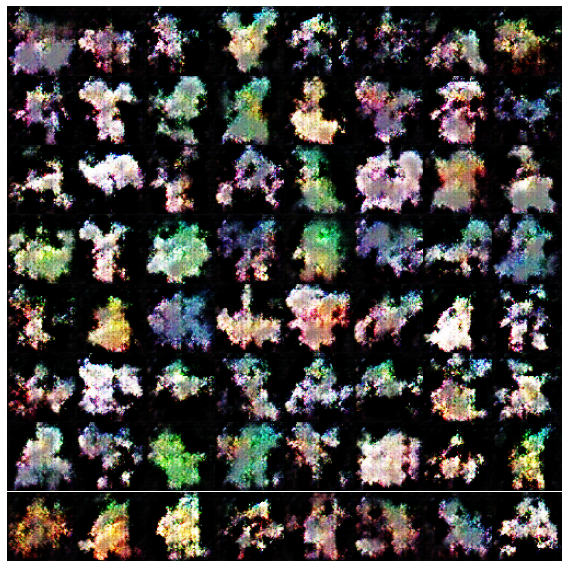

 Batch 50/150 Loss g(7.419542) | d(0.475147) - took 2.433166 s.
 Batch 51/150 Loss g(4.225035) | d(0.353186) - took 0.448323 s.
 Batch 52/150 Loss g(5.373012) | d(0.663684) - took 0.342859 s.
 Batch 53/150 Loss g(4.813925) | d(-0.082262) - took 0.344081 s.
 Batch 54/150 Loss g(5.547151) | d(0.476680) - took 0.348022 s.
 Batch 55/150 Loss g(4.731622) | d(-0.070211) - took 0.350438 s.
 Batch 56/150 Loss g(5.268645) | d(0.471395) - took 0.347421 s.
 Batch 57/150 Loss g(9.212618) | d(0.689878) - took 0.347262 s.
 Batch 58/150 Loss g(11.058316) | d(0.520063) - took 0.350266 s.
 Batch 59/150 Loss g(6.378891) | d(0.610139) - took 0.354695 s.
 Batch 60/150 Loss g(4.907163) | d(0.068301) - took 0.348123 s.
 Batch 61/150 Loss g(6.856846) | d(0.548981) - took 0.288486 s.
 Batch 62/150 Loss g(5.489851) | d(0.466462) - took 0.346359 s.
 Batch 63/150 Loss g(5.402018) | d(0.362547) - took 0.350480 s.
 Batch 64/150 Loss g(5.213859) | d(-0.240085) - took 0.353004 s.
 Batch 65/150 Loss g(5.759790) | d(0

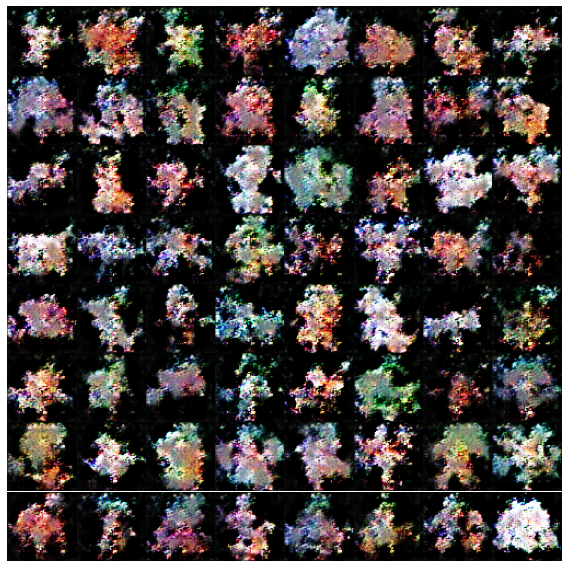

 Batch 150/150 Loss g(10.309221) | d(0.697521) - took 2.423344 s.


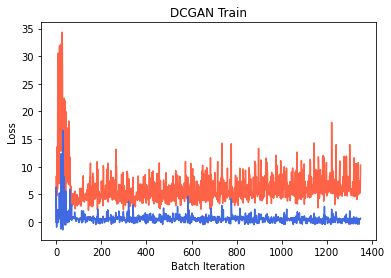

Epoch 10/120 :
 Batch 1/150 Loss g(13.244174) | d(0.479215) - took 0.344661 s.
 Batch 2/150 Loss g(8.690709) | d(0.491211) - took 0.283695 s.
 Batch 3/150 Loss g(6.374623) | d(0.437140) - took 0.351355 s.
 Batch 4/150 Loss g(5.143069) | d(0.511439) - took 0.344882 s.
 Batch 5/150 Loss g(7.601139) | d(0.352539) - took 0.347604 s.
 Batch 6/150 Loss g(6.431512) | d(-0.062600) - took 0.355280 s.
 Batch 7/150 Loss g(6.234365) | d(0.513724) - took 0.351561 s.
 Batch 8/150 Loss g(6.323662) | d(0.435777) - took 0.348122 s.
 Batch 9/150 Loss g(5.228752) | d(0.648799) - took 0.350480 s.
 Batch 10/150 Loss g(7.633493) | d(0.356421) - took 0.346001 s.
 Batch 11/150 Loss g(10.193594) | d(0.443574) - took 0.349076 s.
 Batch 12/150 Loss g(3.967308) | d(0.413989) - took 0.352317 s.
 Batch 13/150 Loss g(14.152887) | d(0.609576) - took 0.344977 s.
 Batch 14/150 Loss g(11.492187) | d(0.254947) - took 0.345433 s.
 Batch 15/150 Loss g(5.941174) | d(-0.323130) - took 0.286179 s.
 Batch 16/150 Loss g(6.54753

<Figure size 432x288 with 0 Axes>

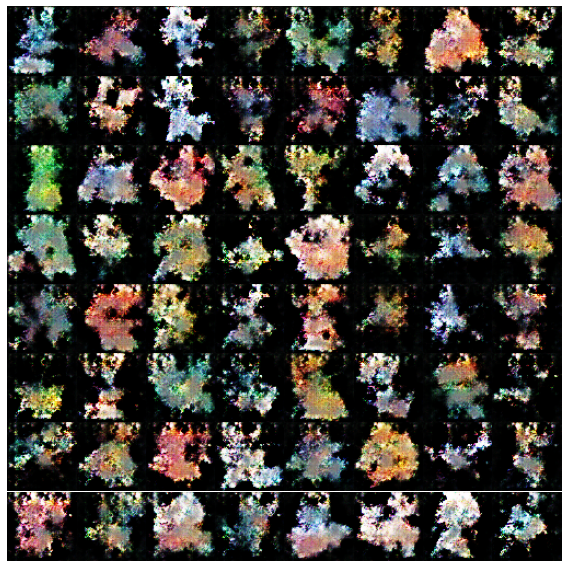

 Batch 50/150 Loss g(6.569319) | d(-0.449244) - took 2.411359 s.
 Batch 51/150 Loss g(8.928632) | d(-0.361325) - took 0.433578 s.
 Batch 52/150 Loss g(6.760976) | d(-0.513566) - took 0.346208 s.
 Batch 53/150 Loss g(7.529557) | d(0.752617) - took 0.351675 s.
 Batch 54/150 Loss g(12.199346) | d(0.468527) - took 0.287079 s.
 Batch 55/150 Loss g(17.192097) | d(0.436778) - took 0.347918 s.
 Batch 56/150 Loss g(5.496620) | d(2.444971) - took 0.348314 s.
 Batch 57/150 Loss g(6.763125) | d(0.854894) - took 0.344788 s.
 Batch 58/150 Loss g(7.307646) | d(0.550555) - took 0.350586 s.
 Batch 59/150 Loss g(9.067474) | d(1.733238) - took 0.355289 s.
 Batch 60/150 Loss g(9.180812) | d(0.598302) - took 0.348850 s.
 Batch 61/150 Loss g(6.183682) | d(0.502950) - took 0.343907 s.
 Batch 62/150 Loss g(5.168039) | d(0.572942) - took 0.357009 s.
 Batch 63/150 Loss g(10.537184) | d(1.128736) - took 0.350454 s.
 Batch 64/150 Loss g(9.887150) | d(0.853109) - took 0.348585 s.
 Batch 65/150 Loss g(6.985591) | d

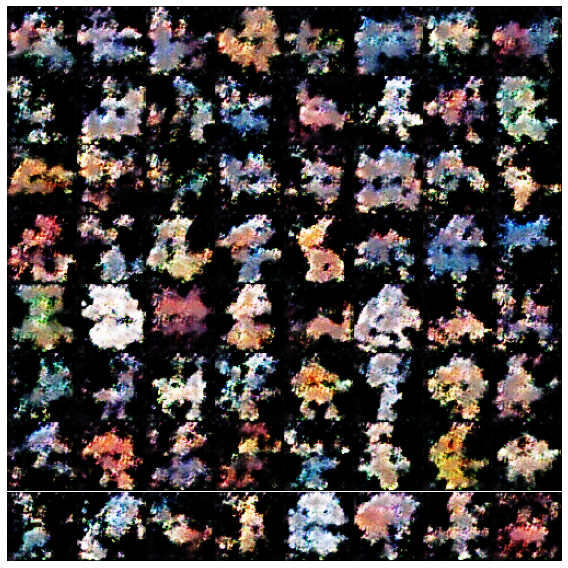

 Batch 100/150 Loss g(5.167277) | d(0.493103) - took 2.391228 s.
 Batch 101/150 Loss g(9.533166) | d(0.751297) - took 0.441032 s.
 Batch 102/150 Loss g(10.650832) | d(-0.141338) - took 0.346499 s.
 Batch 103/150 Loss g(5.335448) | d(-0.023908) - took 0.356409 s.
 Batch 104/150 Loss g(7.860866) | d(0.003455) - took 0.362997 s.
 Batch 105/150 Loss g(11.452437) | d(0.567393) - took 0.345588 s.
 Batch 106/150 Loss g(4.120838) | d(1.016740) - took 0.285518 s.
 Batch 107/150 Loss g(10.333809) | d(0.008764) - took 0.342279 s.
 Batch 108/150 Loss g(15.516000) | d(0.489638) - took 0.344047 s.
 Batch 109/150 Loss g(4.047867) | d(1.953953) - took 0.351377 s.
 Batch 110/150 Loss g(11.959505) | d(1.084170) - took 0.347410 s.
 Batch 111/150 Loss g(13.098557) | d(0.583375) - took 0.354255 s.
 Batch 112/150 Loss g(4.220205) | d(0.957026) - took 0.351846 s.
 Batch 113/150 Loss g(8.545380) | d(0.274657) - took 0.352881 s.
 Batch 114/150 Loss g(8.927912) | d(-0.343170) - took 0.343089 s.
 Batch 115/150 L

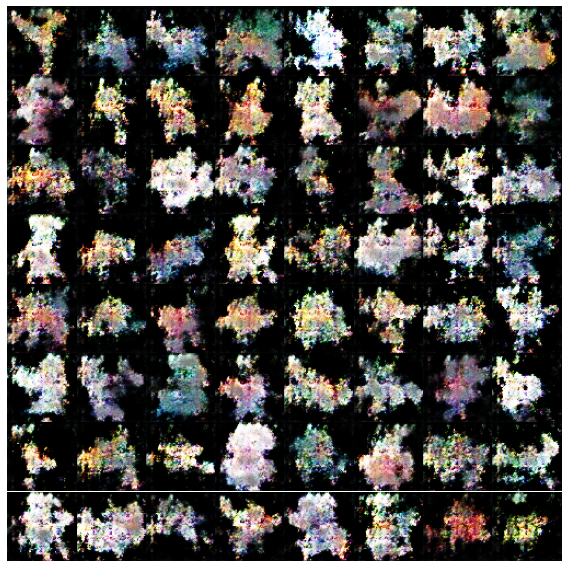

 Batch 150/150 Loss g(6.901842) | d(0.674212) - took 2.378970 s.


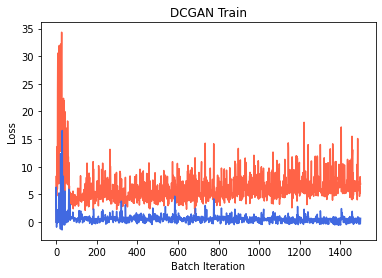

Epoch 11/120 :
 Batch 1/150 Loss g(7.443059) | d(-0.122965) - took 0.366798 s.
 Batch 2/150 Loss g(8.530621) | d(0.423107) - took 0.358028 s.
 Batch 3/150 Loss g(5.853999) | d(0.110465) - took 0.344935 s.
 Batch 4/150 Loss g(6.941004) | d(0.507411) - took 0.349652 s.
 Batch 5/150 Loss g(6.409822) | d(0.502591) - took 0.350171 s.
 Batch 6/150 Loss g(7.182605) | d(0.631915) - took 0.349848 s.
 Batch 7/150 Loss g(6.255727) | d(0.733974) - took 0.354239 s.
 Batch 8/150 Loss g(7.495466) | d(0.481151) - took 0.285682 s.
 Batch 9/150 Loss g(5.997331) | d(0.412977) - took 0.348042 s.
 Batch 10/150 Loss g(6.145072) | d(0.531717) - took 0.356992 s.
 Batch 11/150 Loss g(9.906866) | d(0.926152) - took 0.352735 s.
 Batch 12/150 Loss g(8.407647) | d(-0.056690) - took 0.349994 s.
 Batch 13/150 Loss g(7.169225) | d(0.563504) - took 0.350615 s.
 Batch 14/150 Loss g(5.613797) | d(-0.243504) - took 0.347624 s.
 Batch 15/150 Loss g(6.696887) | d(-0.339727) - took 0.349359 s.
 Batch 16/150 Loss g(5.837835)

<Figure size 432x288 with 0 Axes>

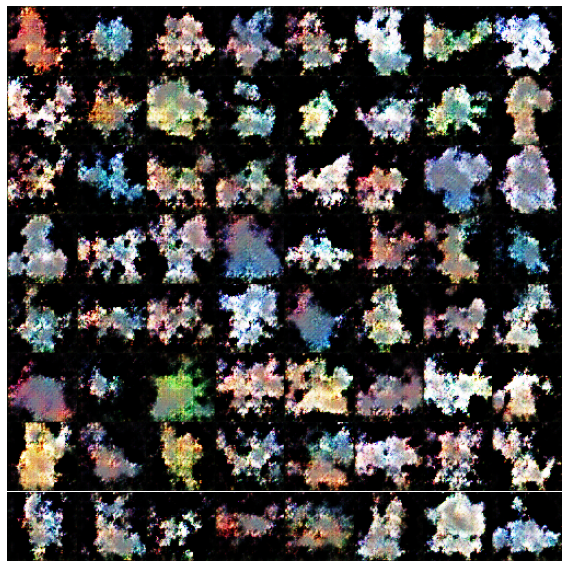

 Batch 50/150 Loss g(12.582004) | d(1.455065) - took 2.429751 s.
 Batch 51/150 Loss g(12.928432) | d(0.895222) - took 0.407227 s.
 Batch 52/150 Loss g(7.536727) | d(0.564314) - took 0.343377 s.
 Batch 53/150 Loss g(6.031161) | d(0.744069) - took 0.349339 s.
 Batch 54/150 Loss g(6.063467) | d(0.338981) - took 0.345046 s.
 Batch 55/150 Loss g(5.371182) | d(-0.210097) - took 0.346286 s.
 Batch 56/150 Loss g(5.886058) | d(0.615768) - took 0.359869 s.
 Batch 57/150 Loss g(5.670515) | d(0.566587) - took 0.347269 s.
 Batch 58/150 Loss g(5.912734) | d(0.700493) - took 0.354629 s.
 Batch 59/150 Loss g(5.847761) | d(0.505507) - took 0.364646 s.
 Batch 60/150 Loss g(4.878317) | d(0.681523) - took 0.285455 s.
 Batch 61/150 Loss g(5.450655) | d(0.556593) - took 0.347355 s.
 Batch 62/150 Loss g(5.339102) | d(0.589383) - took 0.353308 s.
 Batch 63/150 Loss g(9.459177) | d(0.445070) - took 0.350222 s.
 Batch 64/150 Loss g(9.548554) | d(-0.317521) - took 0.349292 s.
 Batch 65/150 Loss g(5.919450) | d(-

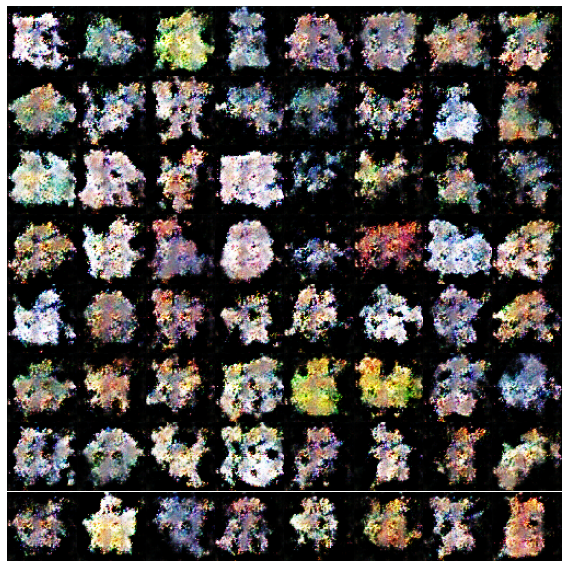

 Batch 100/150 Loss g(13.675930) | d(0.501113) - took 2.406291 s.
 Batch 101/150 Loss g(10.996515) | d(0.538455) - took 0.453542 s.
 Batch 102/150 Loss g(6.137860) | d(-0.561179) - took 0.345432 s.
 Batch 103/150 Loss g(8.965179) | d(-0.264064) - took 0.351490 s.
 Batch 104/150 Loss g(12.481304) | d(0.630651) - took 0.349866 s.
 Batch 105/150 Loss g(6.139727) | d(0.105835) - took 0.346439 s.
 Batch 106/150 Loss g(6.347594) | d(1.006447) - took 0.354040 s.
 Batch 107/150 Loss g(5.524354) | d(-0.282370) - took 0.349024 s.
 Batch 108/150 Loss g(5.915792) | d(-0.229150) - took 0.346089 s.
 Batch 109/150 Loss g(6.006501) | d(-0.384295) - took 0.348279 s.
 Batch 110/150 Loss g(4.817495) | d(-0.389590) - took 0.347136 s.
 Batch 111/150 Loss g(8.388866) | d(-0.305996) - took 0.349322 s.
 Batch 112/150 Loss g(8.048154) | d(-0.593777) - took 0.286568 s.
 Batch 113/150 Loss g(6.030469) | d(-0.547387) - took 0.357139 s.
 Batch 114/150 Loss g(6.588424) | d(-0.536260) - took 0.350219 s.
 Batch 115/1

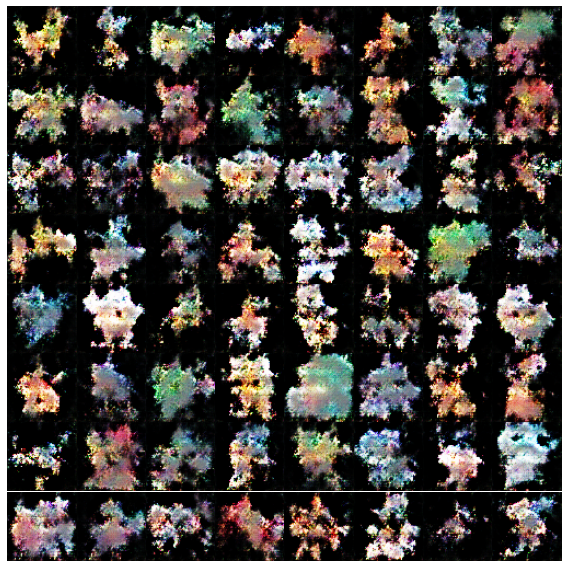

 Batch 150/150 Loss g(5.606852) | d(-0.610442) - took 2.382301 s.


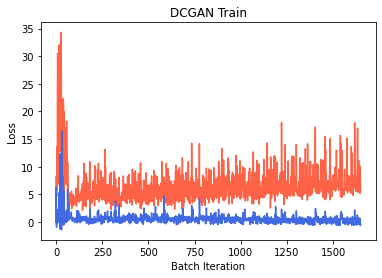

Epoch 12/120 :
 Batch 1/150 Loss g(8.265901) | d(-0.383327) - took 0.288013 s.
 Batch 2/150 Loss g(11.586794) | d(0.793057) - took 0.344849 s.
 Batch 3/150 Loss g(9.805694) | d(0.499406) - took 0.350340 s.
 Batch 4/150 Loss g(5.072987) | d(-0.176905) - took 0.343904 s.
 Batch 5/150 Loss g(6.093380) | d(0.665650) - took 0.348058 s.
 Batch 6/150 Loss g(9.949404) | d(0.398111) - took 0.352860 s.
 Batch 7/150 Loss g(7.997790) | d(0.096495) - took 0.349304 s.
 Batch 8/150 Loss g(4.969563) | d(-0.490912) - took 0.351159 s.
 Batch 9/150 Loss g(8.230952) | d(-0.302436) - took 0.350510 s.
 Batch 10/150 Loss g(8.302067) | d(-0.678601) - took 0.347492 s.
 Batch 11/150 Loss g(5.922045) | d(-0.535362) - took 0.347462 s.
 Batch 12/150 Loss g(7.161839) | d(0.694620) - took 0.347893 s.
 Batch 13/150 Loss g(7.822503) | d(-0.289183) - took 0.347318 s.
 Batch 14/150 Loss g(9.374624) | d(0.508208) - took 0.303106 s.
 Batch 15/150 Loss g(5.280291) | d(0.632977) - took 0.346087 s.
 Batch 16/150 Loss g(15.79

<Figure size 432x288 with 0 Axes>

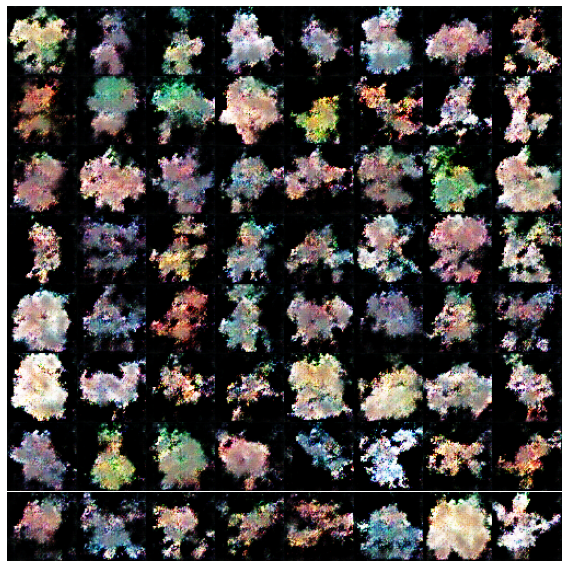

 Batch 50/150 Loss g(10.281816) | d(0.314610) - took 2.379762 s.
 Batch 51/150 Loss g(14.766216) | d(0.498902) - took 0.439873 s.
 Batch 52/150 Loss g(6.258526) | d(1.286963) - took 0.342373 s.
 Batch 53/150 Loss g(7.097394) | d(0.884224) - took 0.285056 s.
 Batch 54/150 Loss g(7.836392) | d(0.039571) - took 0.351937 s.
 Batch 55/150 Loss g(6.504594) | d(-0.353616) - took 0.347115 s.
 Batch 56/150 Loss g(5.550451) | d(-0.340848) - took 0.344251 s.
 Batch 57/150 Loss g(6.923493) | d(0.698809) - took 0.341733 s.
 Batch 58/150 Loss g(6.116363) | d(0.561911) - took 0.350028 s.
 Batch 59/150 Loss g(6.743089) | d(0.608335) - took 0.351042 s.
 Batch 60/150 Loss g(13.614297) | d(1.239944) - took 0.346226 s.
 Batch 61/150 Loss g(17.968315) | d(0.421395) - took 0.342033 s.
 Batch 62/150 Loss g(8.620235) | d(0.957171) - took 0.341991 s.
 Batch 63/150 Loss g(6.099058) | d(0.624337) - took 0.366826 s.
 Batch 64/150 Loss g(5.935828) | d(0.590618) - took 0.355354 s.
 Batch 65/150 Loss g(5.157343) | d

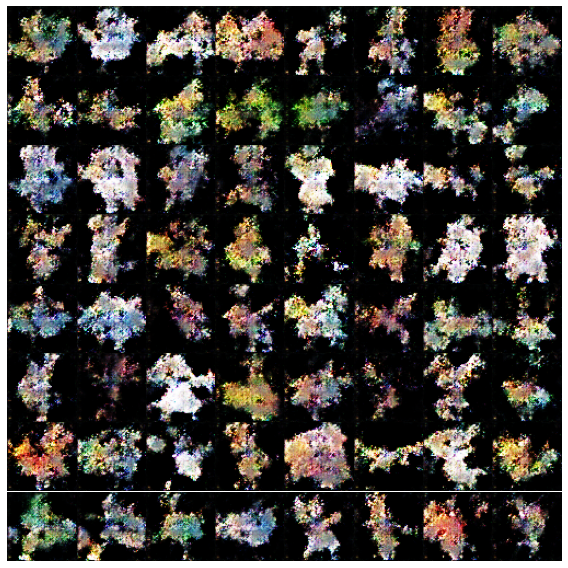

 Batch 100/150 Loss g(6.395014) | d(0.456544) - took 2.382742 s.
 Batch 101/150 Loss g(13.324438) | d(0.437098) - took 0.443408 s.
 Batch 102/150 Loss g(13.267397) | d(0.107290) - took 0.348037 s.
 Batch 103/150 Loss g(7.776581) | d(-0.413298) - took 0.345261 s.
 Batch 104/150 Loss g(6.853566) | d(-0.547267) - took 0.346259 s.
 Batch 105/150 Loss g(7.053573) | d(-0.601633) - took 0.284009 s.
 Batch 106/150 Loss g(5.089416) | d(-0.771530) - took 0.343887 s.
 Batch 107/150 Loss g(11.545925) | d(-0.346833) - took 0.349434 s.
 Batch 108/150 Loss g(16.335188) | d(0.575501) - took 0.344725 s.
 Batch 109/150 Loss g(4.344989) | d(1.631759) - took 0.346385 s.
 Batch 110/150 Loss g(6.118850) | d(1.196963) - took 0.345324 s.
 Batch 111/150 Loss g(5.892240) | d(-0.109177) - took 0.347275 s.
 Batch 112/150 Loss g(7.268679) | d(0.509605) - took 0.349897 s.
 Batch 113/150 Loss g(5.099516) | d(0.608359) - took 0.345441 s.
 Batch 114/150 Loss g(11.957491) | d(0.926966) - took 0.344107 s.
 Batch 115/150

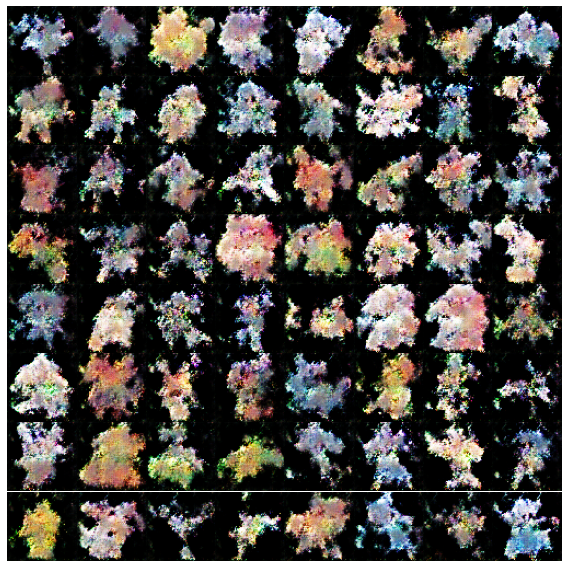

 Batch 150/150 Loss g(7.781836) | d(0.600121) - took 2.407561 s.


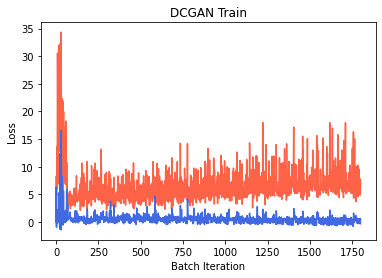

Epoch 13/120 :
 Batch 1/150 Loss g(5.344307) | d(-0.256207) - took 0.353444 s.
 Batch 2/150 Loss g(7.791201) | d(-0.277431) - took 0.345258 s.
 Batch 3/150 Loss g(11.529530) | d(0.597564) - took 0.344809 s.
 Batch 4/150 Loss g(5.758727) | d(0.079290) - took 0.347854 s.
 Batch 5/150 Loss g(8.268358) | d(-0.200568) - took 0.345786 s.
 Batch 6/150 Loss g(8.983159) | d(-0.627219) - took 0.349708 s.
 Batch 7/150 Loss g(8.390321) | d(0.611007) - took 0.285691 s.
 Batch 8/150 Loss g(7.548449) | d(0.586341) - took 0.351227 s.
 Batch 9/150 Loss g(6.038851) | d(-0.111437) - took 0.349800 s.
 Batch 10/150 Loss g(7.530820) | d(0.529040) - took 0.345344 s.
 Batch 11/150 Loss g(5.223111) | d(-0.101468) - took 0.358972 s.
 Batch 12/150 Loss g(6.880202) | d(0.534169) - took 0.351410 s.
 Batch 13/150 Loss g(7.418368) | d(0.444921) - took 0.347568 s.
 Batch 14/150 Loss g(5.823102) | d(0.583528) - took 0.346734 s.
 Batch 15/150 Loss g(13.386391) | d(0.504274) - took 0.351072 s.
 Batch 16/150 Loss g(13.24

<Figure size 432x288 with 0 Axes>

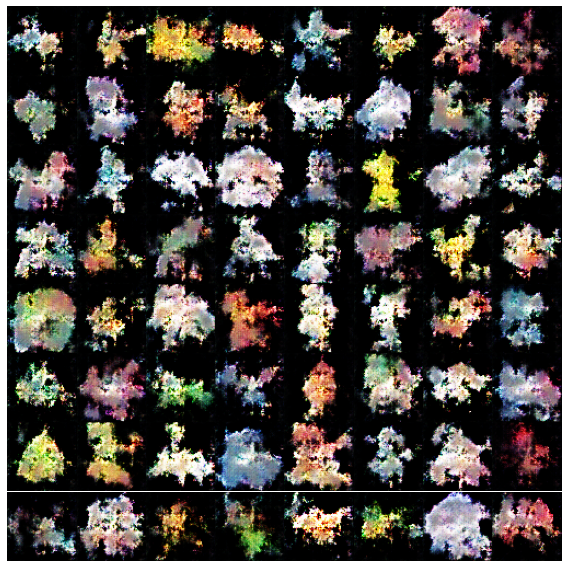

 Batch 50/150 Loss g(5.833347) | d(0.739150) - took 2.389179 s.
 Batch 51/150 Loss g(9.572055) | d(0.890778) - took 0.438288 s.
 Batch 52/150 Loss g(8.249201) | d(0.042448) - took 0.354333 s.
 Batch 53/150 Loss g(7.113187) | d(0.778921) - took 0.352465 s.
 Batch 54/150 Loss g(6.623839) | d(0.578307) - took 0.351006 s.
 Batch 55/150 Loss g(7.597388) | d(0.578860) - took 0.356109 s.
 Batch 56/150 Loss g(6.756534) | d(-0.260348) - took 0.345148 s.
 Batch 57/150 Loss g(7.073969) | d(0.711894) - took 0.349820 s.
 Batch 58/150 Loss g(5.994699) | d(0.472380) - took 0.368706 s.
 Batch 59/150 Loss g(7.082526) | d(0.586778) - took 0.289921 s.
 Batch 60/150 Loss g(10.620674) | d(0.595452) - took 0.347937 s.
 Batch 61/150 Loss g(4.402627) | d(0.405818) - took 0.354111 s.
 Batch 62/150 Loss g(8.320558) | d(1.169445) - took 0.348712 s.
 Batch 63/150 Loss g(10.235832) | d(0.462313) - took 0.345209 s.
 Batch 64/150 Loss g(6.052385) | d(0.719730) - took 0.349306 s.
 Batch 65/150 Loss g(6.155369) | d(0.

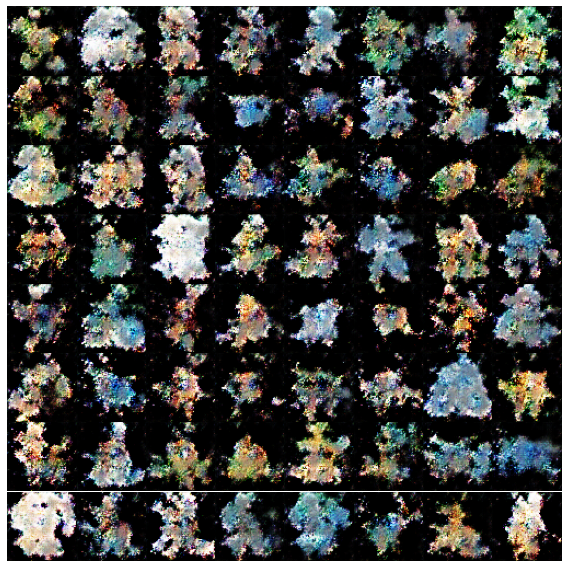

 Batch 100/150 Loss g(6.529334) | d(-0.020122) - took 2.399618 s.
 Batch 101/150 Loss g(8.391131) | d(0.552476) - took 0.454338 s.
 Batch 102/150 Loss g(4.791591) | d(-0.179284) - took 0.351775 s.
 Batch 103/150 Loss g(6.869227) | d(0.666394) - took 0.350957 s.
 Batch 104/150 Loss g(8.652004) | d(0.475599) - took 0.345300 s.
 Batch 105/150 Loss g(6.724143) | d(0.452372) - took 0.350122 s.
 Batch 106/150 Loss g(10.284477) | d(0.445087) - took 0.347128 s.
 Batch 107/150 Loss g(10.820786) | d(-0.178257) - took 0.347216 s.
 Batch 108/150 Loss g(9.515285) | d(0.636882) - took 0.341445 s.
 Batch 109/150 Loss g(7.488695) | d(0.445401) - took 0.344969 s.
 Batch 110/150 Loss g(6.098294) | d(0.547612) - took 0.339603 s.
 Batch 111/150 Loss g(6.047973) | d(-0.001997) - took 0.285905 s.
 Batch 112/150 Loss g(5.771962) | d(-0.379323) - took 0.345449 s.
 Batch 113/150 Loss g(6.557619) | d(-0.236989) - took 0.356202 s.
 Batch 114/150 Loss g(8.785776) | d(0.694735) - took 0.351349 s.
 Batch 115/150 Lo

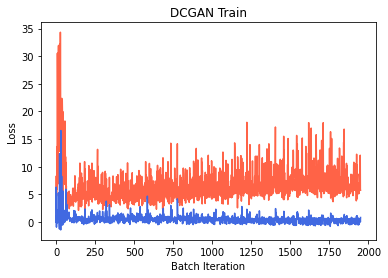

Epoch 14/120 :
 Batch 1/150 Loss g(4.815445) | d(-0.393417) - took 0.359524 s.
 Batch 2/150 Loss g(6.663353) | d(0.809927) - took 0.362713 s.
 Batch 3/150 Loss g(5.481220) | d(-0.167257) - took 0.352610 s.
 Batch 4/150 Loss g(6.406289) | d(0.580880) - took 0.353898 s.
 Batch 5/150 Loss g(5.813784) | d(0.470467) - took 0.351433 s.
 Batch 6/150 Loss g(5.727291) | d(0.454948) - took 0.348082 s.
 Batch 7/150 Loss g(5.328947) | d(0.521093) - took 0.344385 s.
 Batch 8/150 Loss g(9.853007) | d(0.416401) - took 0.350194 s.
 Batch 9/150 Loss g(9.951021) | d(-0.166539) - took 0.342281 s.
 Batch 10/150 Loss g(8.790507) | d(0.540408) - took 0.349652 s.
 Batch 11/150 Loss g(5.425164) | d(-0.461075) - took 0.351859 s.
 Batch 12/150 Loss g(6.231316) | d(-0.482591) - took 0.349809 s.
 Batch 13/150 Loss g(6.067485) | d(-0.586084) - took 0.296010 s.
 Batch 14/150 Loss g(7.455019) | d(0.725398) - took 0.353574 s.
 Batch 15/150 Loss g(7.688890) | d(0.564484) - took 0.347431 s.
 Batch 16/150 Loss g(5.20035

<Figure size 432x288 with 0 Axes>

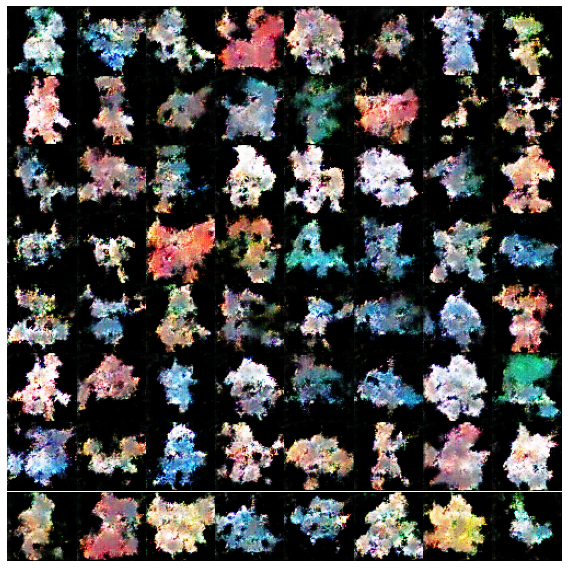

 Batch 50/150 Loss g(5.319657) | d(-0.262275) - took 2.388580 s.
 Batch 51/150 Loss g(9.408385) | d(-0.237886) - took 0.431178 s.
 Batch 52/150 Loss g(11.828393) | d(0.520146) - took 0.287893 s.
 Batch 53/150 Loss g(6.387499) | d(0.602683) - took 0.348384 s.
 Batch 54/150 Loss g(6.020414) | d(0.668215) - took 0.353369 s.
 Batch 55/150 Loss g(6.558339) | d(0.483718) - took 0.351167 s.
 Batch 56/150 Loss g(11.245119) | d(1.282457) - took 0.355374 s.
 Batch 57/150 Loss g(10.246773) | d(-0.213939) - took 0.343907 s.
 Batch 58/150 Loss g(5.716757) | d(-0.058223) - took 0.345717 s.
 Batch 59/150 Loss g(8.636120) | d(-0.263552) - took 0.343829 s.
 Batch 60/150 Loss g(11.852569) | d(0.600369) - took 0.347281 s.
 Batch 61/150 Loss g(9.407417) | d(0.459440) - took 0.345688 s.
 Batch 62/150 Loss g(6.751918) | d(0.550326) - took 0.352966 s.
 Batch 63/150 Loss g(7.680999) | d(0.193944) - took 0.350053 s.
 Batch 64/150 Loss g(7.137040) | d(-0.268364) - took 0.352870 s.
 Batch 65/150 Loss g(7.024179)

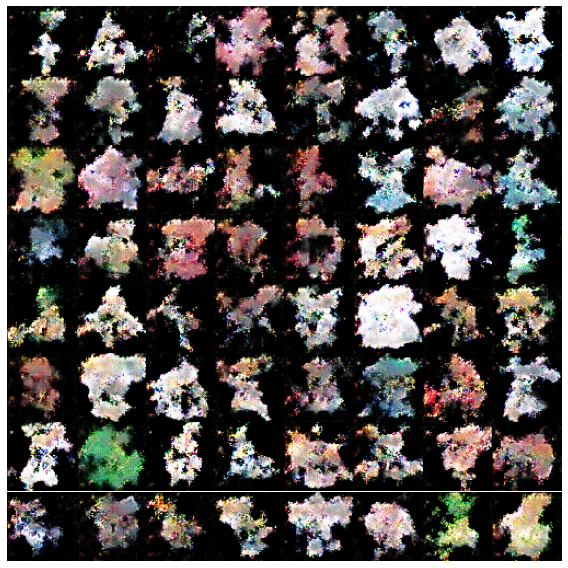

 Batch 100/150 Loss g(12.136622) | d(0.704271) - took 2.392962 s.
 Batch 101/150 Loss g(8.292582) | d(0.645309) - took 0.424663 s.
 Batch 102/150 Loss g(4.658484) | d(-0.334282) - took 0.347036 s.
 Batch 103/150 Loss g(6.611744) | d(-0.511318) - took 0.351372 s.
 Batch 104/150 Loss g(7.027189) | d(-0.667898) - took 0.290093 s.
 Batch 105/150 Loss g(5.955314) | d(-0.684198) - took 0.350807 s.
 Batch 106/150 Loss g(7.145303) | d(0.749111) - took 0.351229 s.
 Batch 107/150 Loss g(8.203419) | d(0.653077) - took 0.352811 s.
 Batch 108/150 Loss g(6.790067) | d(0.540014) - took 0.341584 s.
 Batch 109/150 Loss g(7.097986) | d(0.516168) - took 0.349649 s.
 Batch 110/150 Loss g(6.147159) | d(0.591841) - took 0.346917 s.
 Batch 111/150 Loss g(7.460995) | d(0.445137) - took 0.347753 s.
 Batch 112/150 Loss g(5.830803) | d(0.536601) - took 0.345748 s.
 Batch 113/150 Loss g(6.654119) | d(0.525201) - took 0.345656 s.
 Batch 114/150 Loss g(6.294541) | d(0.471730) - took 0.349983 s.
 Batch 115/150 Loss 

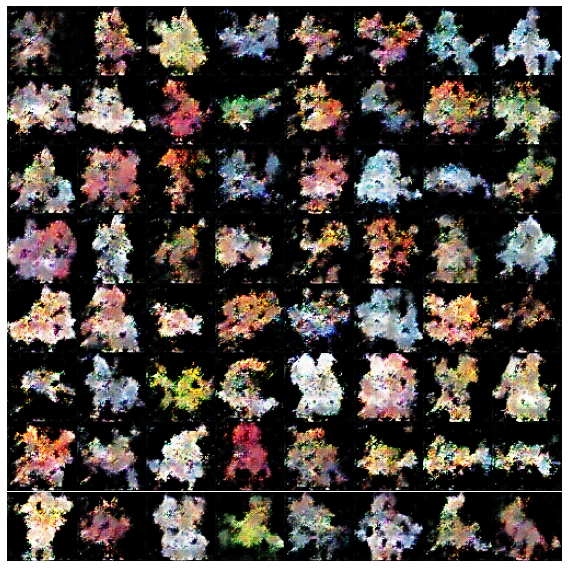

 Batch 150/150 Loss g(5.892388) | d(0.233496) - took 2.359562 s.


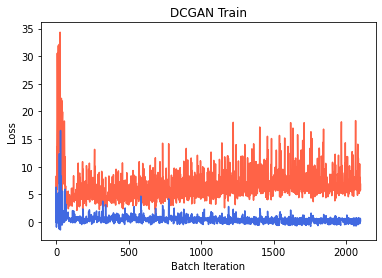

Epoch 15/120 :
 Batch 1/150 Loss g(6.603774) | d(-0.527578) - took 0.345446 s.
 Batch 2/150 Loss g(8.035485) | d(0.820039) - took 0.352777 s.
 Batch 3/150 Loss g(8.796924) | d(0.602825) - took 0.348369 s.
 Batch 4/150 Loss g(6.607377) | d(0.474660) - took 0.349324 s.
 Batch 5/150 Loss g(6.707319) | d(0.457109) - took 0.347957 s.
 Batch 6/150 Loss g(6.249638) | d(0.537086) - took 0.285152 s.
 Batch 7/150 Loss g(5.930382) | d(0.486042) - took 0.341423 s.
 Batch 8/150 Loss g(6.058326) | d(0.482573) - took 0.346442 s.
 Batch 9/150 Loss g(6.600645) | d(0.435813) - took 0.354672 s.
 Batch 10/150 Loss g(13.102637) | d(0.535982) - took 0.347773 s.
 Batch 11/150 Loss g(15.493888) | d(-0.386257) - took 0.351142 s.
 Batch 12/150 Loss g(9.249044) | d(-0.567593) - took 0.343179 s.
 Batch 13/150 Loss g(7.529814) | d(0.706202) - took 0.348652 s.
 Batch 14/150 Loss g(5.262234) | d(-0.431618) - took 0.344991 s.
 Batch 15/150 Loss g(6.576138) | d(-0.575673) - took 0.348171 s.
 Batch 16/150 Loss g(6.4081

<Figure size 432x288 with 0 Axes>

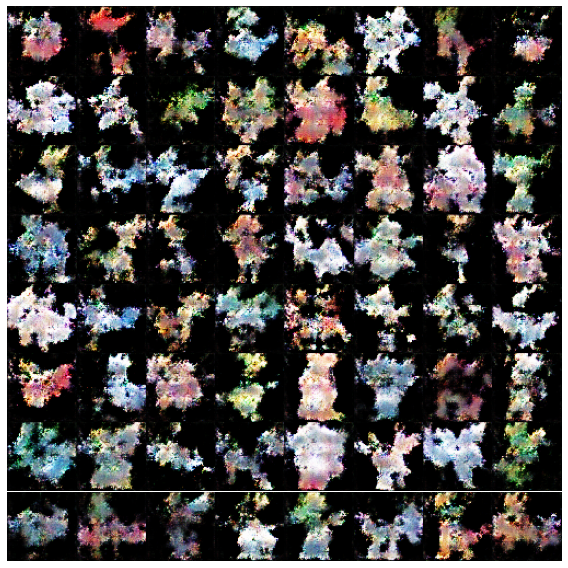

 Batch 50/150 Loss g(6.227757) | d(-0.401651) - took 2.398268 s.
 Batch 51/150 Loss g(6.919067) | d(-0.385603) - took 0.438879 s.
 Batch 52/150 Loss g(6.033145) | d(-0.656547) - took 0.349677 s.
 Batch 53/150 Loss g(5.732638) | d(-0.748667) - took 0.353259 s.
 Batch 54/150 Loss g(7.534550) | d(0.835755) - took 0.353999 s.
 Batch 55/150 Loss g(5.418536) | d(-0.589776) - took 0.354616 s.
 Batch 56/150 Loss g(8.650109) | d(-0.361555) - took 0.355752 s.
 Batch 57/150 Loss g(13.395855) | d(0.599212) - took 0.352265 s.
 Batch 58/150 Loss g(9.557474) | d(0.626374) - took 0.292674 s.
 Batch 59/150 Loss g(5.086893) | d(-0.313633) - took 0.352845 s.
 Batch 60/150 Loss g(6.449230) | d(0.887393) - took 0.349096 s.
 Batch 61/150 Loss g(6.054728) | d(-0.477644) - took 0.354179 s.
 Batch 62/150 Loss g(7.465972) | d(0.584931) - took 0.348548 s.
 Batch 63/150 Loss g(7.663597) | d(0.495296) - took 0.350656 s.
 Batch 64/150 Loss g(7.232257) | d(0.859079) - took 0.350986 s.
 Batch 65/150 Loss g(9.525640) 

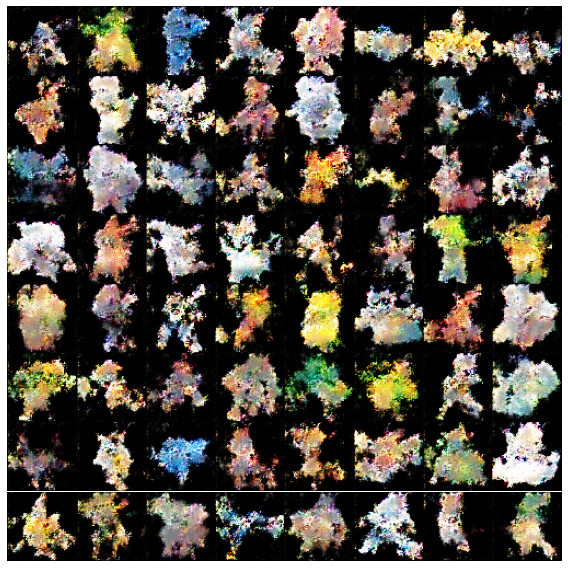

 Batch 100/150 Loss g(15.128814) | d(0.663606) - took 2.428966 s.
 Batch 101/150 Loss g(8.908532) | d(0.749962) - took 0.446696 s.
 Batch 102/150 Loss g(7.694776) | d(0.597160) - took 0.344956 s.
 Batch 103/150 Loss g(7.089720) | d(0.521299) - took 0.347498 s.
 Batch 104/150 Loss g(7.121881) | d(0.197318) - took 0.350451 s.
 Batch 105/150 Loss g(6.548507) | d(-0.398547) - took 0.347730 s.
 Batch 106/150 Loss g(7.077782) | d(-0.423790) - took 0.344109 s.
 Batch 107/150 Loss g(6.935110) | d(-0.763756) - took 0.347768 s.
 Batch 108/150 Loss g(8.216547) | d(1.019344) - took 0.343496 s.
 Batch 109/150 Loss g(9.138062) | d(0.703874) - took 0.354640 s.
 Batch 110/150 Loss g(7.872082) | d(0.562473) - took 0.288302 s.
 Batch 111/150 Loss g(5.767196) | d(0.438733) - took 0.340302 s.
 Batch 112/150 Loss g(6.741250) | d(0.568968) - took 0.351653 s.
 Batch 113/150 Loss g(6.237984) | d(0.515156) - took 0.352252 s.
 Batch 114/150 Loss g(6.767249) | d(0.497976) - took 0.346579 s.
 Batch 115/150 Loss g

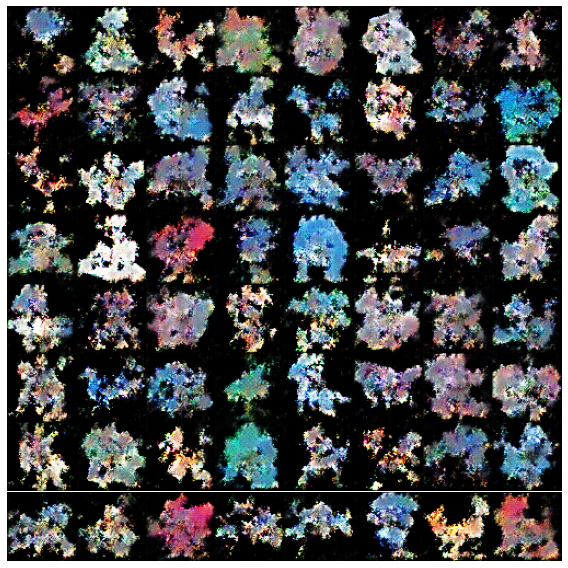

 Batch 150/150 Loss g(6.019332) | d(0.024757) - took 2.412670 s.


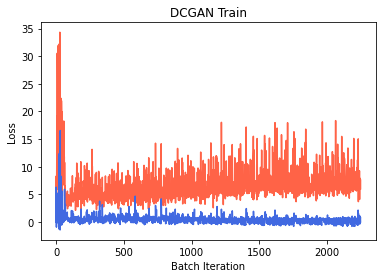

Epoch 16/120 :
 Batch 1/150 Loss g(10.806741) | d(-0.114255) - took 0.358942 s.
 Batch 2/150 Loss g(11.301143) | d(-0.433940) - took 0.351512 s.
 Batch 3/150 Loss g(9.101224) | d(0.618053) - took 0.355534 s.
 Batch 4/150 Loss g(7.522985) | d(0.553359) - took 0.352601 s.
 Batch 5/150 Loss g(5.508613) | d(0.673068) - took 0.350100 s.
 Batch 6/150 Loss g(6.268331) | d(0.584614) - took 0.359457 s.
 Batch 7/150 Loss g(10.710793) | d(1.005518) - took 0.348269 s.
 Batch 8/150 Loss g(13.206729) | d(-0.513559) - took 0.345815 s.
 Batch 9/150 Loss g(7.891164) | d(-0.338186) - took 0.345898 s.
 Batch 10/150 Loss g(7.833648) | d(0.918842) - took 0.352610 s.
 Batch 11/150 Loss g(9.050735) | d(0.646589) - took 0.343224 s.
 Batch 12/150 Loss g(5.336068) | d(0.654955) - took 0.287950 s.
 Batch 13/150 Loss g(9.474015) | d(0.205736) - took 0.350168 s.
 Batch 14/150 Loss g(10.582184) | d(-0.427311) - took 0.347289 s.
 Batch 15/150 Loss g(8.801322) | d(0.555944) - took 0.344362 s.
 Batch 16/150 Loss g(5.4

<Figure size 432x288 with 0 Axes>

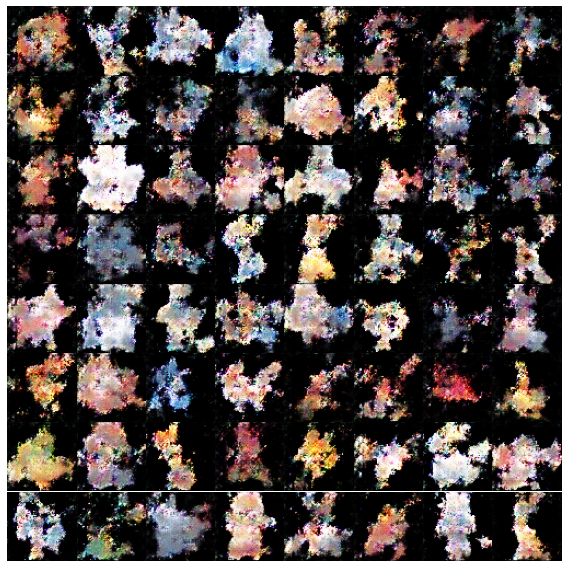

 Batch 50/150 Loss g(7.293007) | d(-0.676750) - took 2.417962 s.
 Batch 51/150 Loss g(7.250115) | d(-0.833129) - took 0.354346 s.
 Batch 52/150 Loss g(7.292652) | d(1.052431) - took 0.341198 s.
 Batch 53/150 Loss g(6.373298) | d(-0.674257) - took 0.350786 s.
 Batch 54/150 Loss g(8.028942) | d(0.790312) - took 0.351115 s.
 Batch 55/150 Loss g(5.996636) | d(-0.134115) - took 0.347389 s.
 Batch 56/150 Loss g(6.928481) | d(-0.547726) - took 0.345435 s.
 Batch 57/150 Loss g(6.394344) | d(-0.758509) - took 0.349813 s.
 Batch 58/150 Loss g(7.125293) | d(0.773388) - took 0.353681 s.
 Batch 59/150 Loss g(8.456744) | d(0.659246) - took 0.347420 s.
 Batch 60/150 Loss g(6.890716) | d(0.020794) - took 0.351187 s.
 Batch 61/150 Loss g(6.823308) | d(-0.487978) - took 0.350260 s.
 Batch 62/150 Loss g(7.875860) | d(-0.476720) - took 0.349418 s.
 Batch 63/150 Loss g(6.744241) | d(-0.608676) - took 0.350621 s.
 Batch 64/150 Loss g(7.002315) | d(-0.755325) - took 0.288546 s.
 Batch 65/150 Loss g(6.155030)

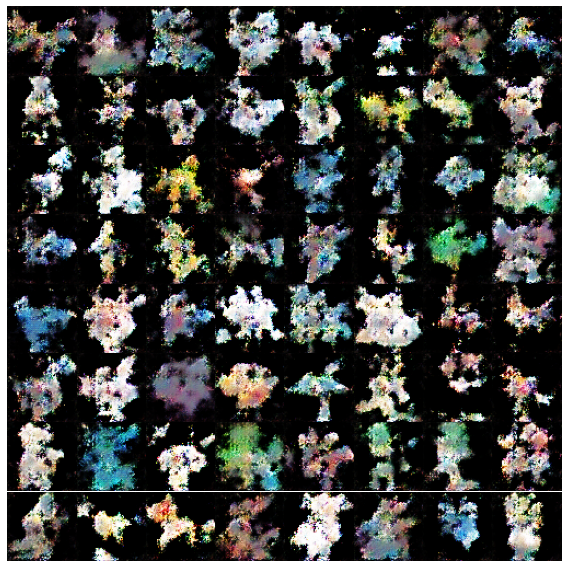

 Batch 100/150 Loss g(13.042578) | d(0.691223) - took 2.414203 s.
 Batch 101/150 Loss g(13.740029) | d(-0.222370) - took 0.425151 s.
 Batch 102/150 Loss g(11.325788) | d(0.596638) - took 0.348027 s.
 Batch 103/150 Loss g(9.613147) | d(0.495041) - took 0.294093 s.
 Batch 104/150 Loss g(8.161297) | d(0.571795) - took 0.366875 s.
 Batch 105/150 Loss g(5.504104) | d(0.542085) - took 0.345832 s.
 Batch 106/150 Loss g(9.446977) | d(0.251639) - took 0.351748 s.
 Batch 107/150 Loss g(8.387381) | d(-0.066993) - took 0.348336 s.
 Batch 108/150 Loss g(8.078337) | d(0.626698) - took 0.354703 s.
 Batch 109/150 Loss g(6.372947) | d(-0.508299) - took 0.350241 s.
 Batch 110/150 Loss g(6.957180) | d(-0.547325) - took 0.355111 s.
 Batch 111/150 Loss g(6.668454) | d(-0.916606) - took 0.352439 s.
 Batch 112/150 Loss g(8.411989) | d(-0.479801) - took 0.365741 s.
 Batch 113/150 Loss g(7.718133) | d(-0.794242) - took 0.378137 s.
 Batch 114/150 Loss g(7.187215) | d(-0.863635) - took 0.374036 s.
 Batch 115/150

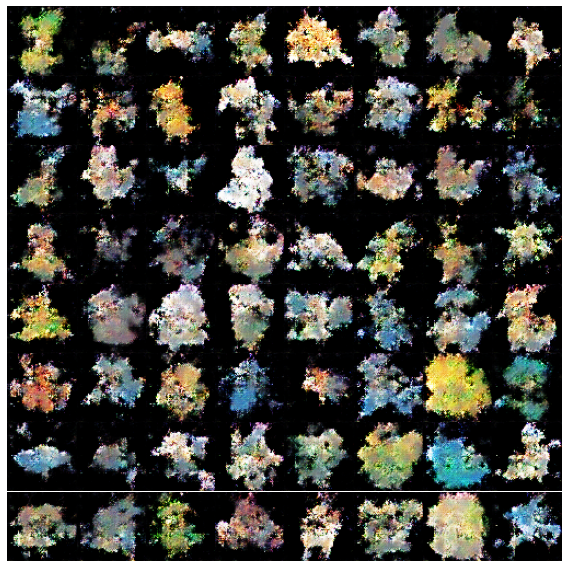

 Batch 150/150 Loss g(8.601683) | d(-0.769525) - took 2.342069 s.


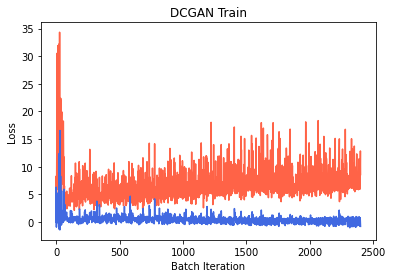

Epoch 17/120 :
 Batch 1/150 Loss g(7.984100) | d(1.038796) - took 0.345533 s.
 Batch 2/150 Loss g(6.203329) | d(-0.681215) - took 0.346382 s.
 Batch 3/150 Loss g(8.184661) | d(-0.590640) - took 0.347564 s.
 Batch 4/150 Loss g(11.241686) | d(0.842700) - took 0.348006 s.
 Batch 5/150 Loss g(10.864676) | d(0.555904) - took 0.284942 s.
 Batch 6/150 Loss g(8.145271) | d(0.542726) - took 0.345115 s.
 Batch 7/150 Loss g(6.853633) | d(-0.152324) - took 0.352443 s.
 Batch 8/150 Loss g(9.349534) | d(0.816818) - took 0.352700 s.
 Batch 9/150 Loss g(5.994683) | d(-0.202982) - took 0.347322 s.
 Batch 10/150 Loss g(7.649107) | d(0.845256) - took 0.345970 s.
 Batch 11/150 Loss g(5.641793) | d(-0.496649) - took 0.352996 s.
 Batch 12/150 Loss g(6.853385) | d(0.767157) - took 0.347870 s.
 Batch 13/150 Loss g(7.758033) | d(0.557703) - took 0.343492 s.
 Batch 14/150 Loss g(9.229109) | d(0.159220) - took 0.341697 s.
 Batch 15/150 Loss g(12.550738) | d(0.456050) - took 0.352309 s.
 Batch 16/150 Loss g(7.906

<Figure size 432x288 with 0 Axes>

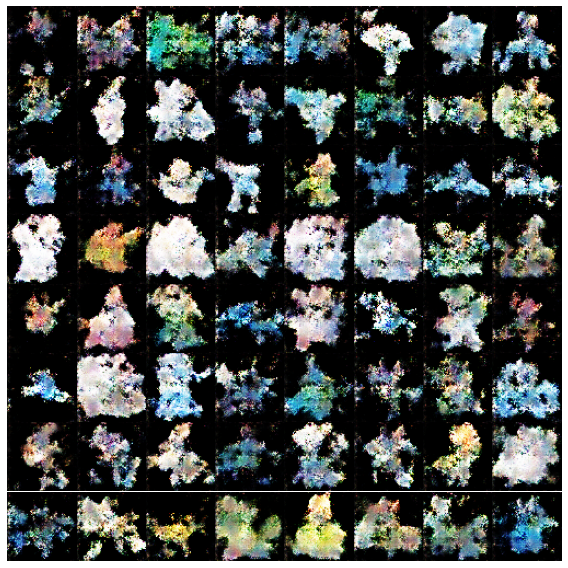

 Batch 50/150 Loss g(7.864777) | d(-0.582936) - took 2.355911 s.
 Batch 51/150 Loss g(6.418965) | d(-0.563099) - took 0.446122 s.
 Batch 52/150 Loss g(6.615917) | d(-0.863440) - took 0.353498 s.
 Batch 53/150 Loss g(7.943901) | d(0.982386) - took 0.360915 s.
 Batch 54/150 Loss g(5.933945) | d(-0.588498) - took 0.349967 s.
 Batch 55/150 Loss g(8.259815) | d(0.750751) - took 0.356769 s.
 Batch 56/150 Loss g(6.711462) | d(-0.459237) - took 0.347349 s.
 Batch 57/150 Loss g(8.594563) | d(-0.613657) - took 0.284986 s.
 Batch 58/150 Loss g(11.215845) | d(0.901085) - took 0.351026 s.
 Batch 59/150 Loss g(10.910943) | d(0.708450) - took 0.348378 s.
 Batch 60/150 Loss g(5.975500) | d(-0.100754) - took 0.350242 s.
 Batch 61/150 Loss g(10.522207) | d(-0.414052) - took 0.351628 s.
 Batch 62/150 Loss g(14.644781) | d(0.650806) - took 0.348292 s.
 Batch 63/150 Loss g(8.172997) | d(-0.140567) - took 0.352522 s.
 Batch 64/150 Loss g(7.790191) | d(1.061474) - took 0.348789 s.
 Batch 65/150 Loss g(6.9861

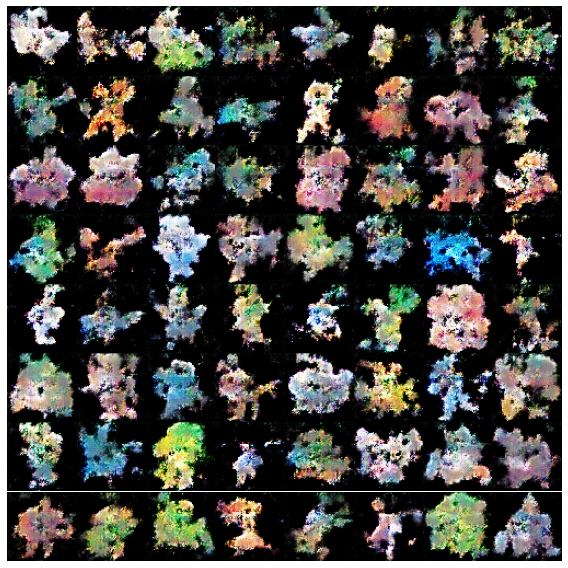

 Batch 100/150 Loss g(8.123575) | d(0.731644) - took 2.360682 s.
 Batch 101/150 Loss g(6.808756) | d(-0.365522) - took 0.448759 s.
 Batch 102/150 Loss g(6.999262) | d(-0.443593) - took 0.354036 s.
 Batch 103/150 Loss g(6.642982) | d(-0.642790) - took 0.353044 s.
 Batch 104/150 Loss g(8.070889) | d(0.840581) - took 0.350573 s.
 Batch 105/150 Loss g(8.371206) | d(0.669884) - took 0.351067 s.
 Batch 106/150 Loss g(7.464352) | d(-0.084980) - took 0.347929 s.
 Batch 107/150 Loss g(6.273600) | d(-0.694980) - took 0.347987 s.
 Batch 108/150 Loss g(7.931036) | d(0.938693) - took 0.348917 s.
 Batch 109/150 Loss g(6.744259) | d(-0.484047) - took 0.290354 s.
 Batch 110/150 Loss g(7.330295) | d(-0.617312) - took 0.351119 s.
 Batch 111/150 Loss g(10.206730) | d(0.878790) - took 0.351184 s.
 Batch 112/150 Loss g(7.653769) | d(-0.210765) - took 0.346986 s.
 Batch 113/150 Loss g(8.862528) | d(0.863993) - took 0.349187 s.
 Batch 114/150 Loss g(9.776422) | d(0.651165) - took 0.357714 s.
 Batch 115/150 L

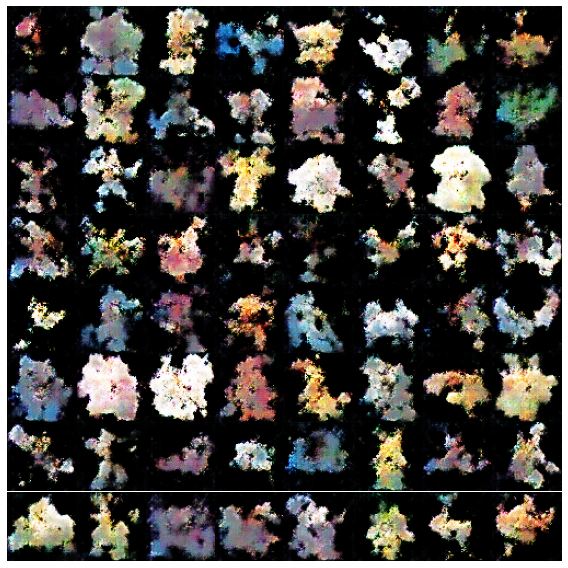

 Batch 150/150 Loss g(6.462899) | d(1.252812) - took 2.381434 s.


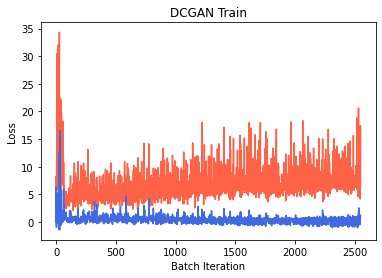

Epoch 18/120 :
 Batch 1/150 Loss g(7.886343) | d(1.162246) - took 0.343133 s.
 Batch 2/150 Loss g(6.000322) | d(0.001581) - took 0.349831 s.
 Batch 3/150 Loss g(7.385060) | d(0.773511) - took 0.356250 s.
 Batch 4/150 Loss g(5.905208) | d(-0.106455) - took 0.347865 s.
 Batch 5/150 Loss g(5.480400) | d(-0.441486) - took 0.354402 s.
 Batch 6/150 Loss g(7.473926) | d(-0.241857) - took 0.351025 s.
 Batch 7/150 Loss g(8.304308) | d(-0.798149) - took 0.352677 s.
 Batch 8/150 Loss g(7.107683) | d(0.820289) - took 0.348803 s.
 Batch 9/150 Loss g(6.229779) | d(0.592097) - took 0.348826 s.
 Batch 10/150 Loss g(11.329192) | d(0.751125) - took 0.347135 s.
 Batch 11/150 Loss g(13.466502) | d(0.594802) - took 0.295543 s.
 Batch 12/150 Loss g(8.696047) | d(0.650470) - took 0.352005 s.
 Batch 13/150 Loss g(7.180117) | d(0.622039) - took 0.354181 s.
 Batch 14/150 Loss g(6.735991) | d(0.000364) - took 0.356944 s.
 Batch 15/150 Loss g(5.974509) | d(-0.361299) - took 0.353835 s.
 Batch 16/150 Loss g(7.3167

<Figure size 432x288 with 0 Axes>

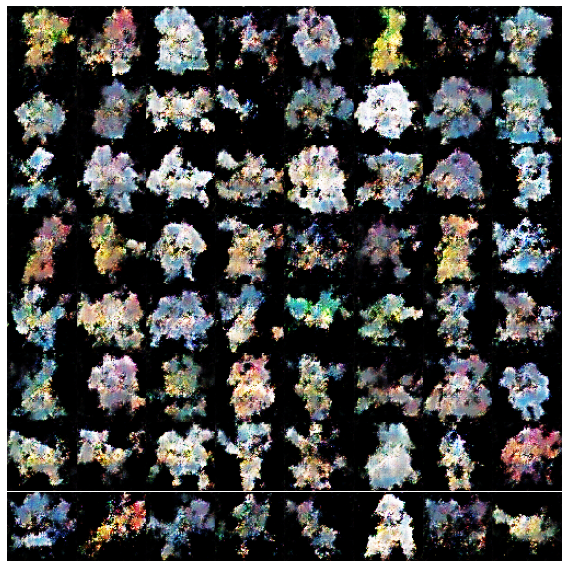

 Batch 100/150 Loss g(6.344342) | d(-0.632264) - took 2.410239 s.
 Batch 101/150 Loss g(6.745756) | d(0.671748) - took 0.449207 s.
 Batch 102/150 Loss g(8.174505) | d(0.646838) - took 0.296225 s.
 Batch 103/150 Loss g(10.556435) | d(0.079429) - took 0.355502 s.
 Batch 104/150 Loss g(13.761209) | d(0.486226) - took 0.353972 s.
 Batch 105/150 Loss g(8.012175) | d(-0.121980) - took 0.357417 s.
 Batch 106/150 Loss g(6.901872) | d(-0.613725) - took 0.356213 s.
 Batch 107/150 Loss g(6.165390) | d(-0.919424) - took 0.354900 s.
 Batch 108/150 Loss g(7.455748) | d(-0.890430) - took 0.347983 s.
 Batch 109/150 Loss g(7.438168) | d(-1.014215) - took 0.344014 s.
 Batch 110/150 Loss g(6.366120) | d(-1.070184) - took 0.346729 s.
 Batch 111/150 Loss g(7.203533) | d(1.269306) - took 0.347231 s.
 Batch 112/150 Loss g(6.946586) | d(-0.850032) - took 0.343103 s.
 Batch 113/150 Loss g(6.627167) | d(-0.898591) - took 0.355886 s.
 Batch 114/150 Loss g(8.865231) | d(-0.927903) - took 0.343761 s.
 Batch 115/15

In [0]:
if __name__ == "__main__":
    main()